<a href="https://colab.research.google.com/github/davidogm/DataScience/blob/main/ITBD/trabajos2024/Tarea_1_ITBD_Estudio_Terremotos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**[ Tarea 1 - ITBD : Estudio de Terremotos ]**
> Trabajo realizado por:
- José Melgarejo Hernández.
- Paula García-Tapia Mateo.



<a href="https://colab.research.google.com/drive/1PhMxVuT-JW_msItX6qeRVjIHDeopfCI8?usp=sharing" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 0. Definición del Entorno


## -- 0.1. Instalación e Importación de Librerías y Configuración del Entorno

In [ ]:
# Instalación de librerías
!pip install -q dask[complete] dask-geopandas geopandas shap

In [ ]:
# Importación de librerías
import warnings
import os
import math
import tempfile
from time import time

# Manejo de datos
import numpy as np
import pandas as pd
import dask.dataframe as dd
import geopandas as gpd
import dask_geopandas as dgpd
import json

# Visualización
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import to_hex
import matplotlib.patches as mpatches

# Machine Learning y métricas
import sklearn as sk
from sklearn.model_selection import train_test_split, StratifiedKFold, KFold, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import (
    confusion_matrix, ConfusionMatrixDisplay, accuracy_score,
    precision_score, recall_score, f1_score, roc_auc_score
)

# SHAP (interpretación de modelos)
import shap as sh
from shap import sample, KernelExplainer, summary_plot, dependence_plot, force_plot, decision_plot
from shap.plots import beeswarm, violin, heatmap, waterfall, scatter

# Geometría y manipulación geoespacial
from shapely.geometry import Point, Polygon, box

# Visualización interactiva con mapas
from ipyleaflet import Map, CircleMarker, LayerGroup, GeoJSON, basemaps, TileLayer, Polyline
from ipywidgets import VBox, Output, Layout, Dropdown, HTML, Combobox

# Visualización de imágenes y manejo de archivos
from IPython.display import Image, display
import imageio.v2 as imageio

# Librerías específicas de Google Colab
import google.colab as gc
from google.colab import drive

# TensorFlow y Keras
import tensorflow as tf
import keras as kr
from keras import Sequential
from keras.layers import InputLayer, Dense, Dropout
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, LearningRateScheduler
from keras.regularizers import l2

In [ ]:
# Ignorar advertencias específicas
warnings.filterwarnings("ignore", category=FutureWarning, module="seaborn")

# Montar Google Drive
drive.mount('/content/gdrive', force_remount=True)
os.chdir('/content/gdrive/MyDrive/Máster Ciencia de Datos UA/[ 1º - Infraestructuras y Tecnologías Big Data ]/')

# Imprimir versiones de algunas librerías clave
print(f'Numpy version: {np.__version__}')
print(f'Pandas version: {pd.__version__}')
print(f'MatPlotLib version: {mpl.__version__}')
print(f'Scikit-Learn version: {sk.__version__}')
print(f'SHAP version: {sh.__version__}')
print(f'TensorFlow version: {tf.__version__}')

Mounted at /content/gdrive
Numpy version: 1.26.4
Pandas version: 2.2.2
MatPlotLib version: 3.7.1
Scikit-Learn version: 1.5.2
SHAP version: 0.46.0
TensorFlow version: 2.17.0


## -- 0.2. Definición de Funciones y Variables de Apoyo

### --- 0.2.1. Funciones y Variables Orientadas a la Visualización de Datos

In [ ]:
BOLD_ON = "\033[1m"
BOLD_OFF = "\033[0m"

In [ ]:
def obtener_paleta_sns(nombre_paleta, num_colores):
  return sns.color_palette(nombre_paleta, n_colors=num_colores)

colors_blue = sns.color_palette("Blues", n_colors=3)
colors_purple = sns.color_palette("Purples", n_colors=3)
colors_red = sns.color_palette("Reds", n_colors=3)

In [ ]:
def generar_variables_ordenadas(datasets):
    lista_variables = sorted(set().union(*(ds.columns for ds in datasets)))
    coincidencias = {var: sum(var in ds.columns for ds in datasets) for var in lista_variables}

    return sorted(coincidencias.items(), key=lambda item: item[1], reverse=True)

In [ ]:
def generar_tabla_coincidencias(datasets, nombres_datasets):
    variables_ordenadas = generar_variables_ordenadas(datasets)
    info_var_ds = {nombre: ['X' if var in ds.columns else ' ' for var, _ in variables_ordenadas]
                   for nombre, ds in zip(nombres_datasets, datasets)}
    info_var_ds[' '] = [var for var, _ in variables_ordenadas]

    tabla_info = pd.DataFrame(info_var_ds).set_index(' ')

    with pd.option_context('display.max_colwidth', None, 'display.max_columns', None):
        mitad = len(tabla_info) // 2
        display(tabla_info.iloc[:mitad].T)
        print()
        display(tabla_info.iloc[mitad:].T)

In [ ]:
def generar_tabla_resultados(datasets, nombres_datasets):
    variables_ordenadas = generar_variables_ordenadas(datasets)
    info_var_ds = {nombre: [ds[var].iloc[0] if var in ds.columns else " " for var, _ in variables_ordenadas]
                   for nombre, ds in zip(nombres_datasets, datasets)}
    info_var_ds[' '] = [var for var, _ in variables_ordenadas]

    tabla_info = pd.DataFrame(info_var_ds).set_index(' ')

    with pd.option_context('display.max_colwidth', None, 'display.max_columns', None):
        mitad = len(tabla_info) // 2
        display(tabla_info.iloc[:mitad].T)
        print()
        display(tabla_info.iloc[mitad:].T)

In [ ]:
def recopilar_info_ds(dataset, nombre_dataset):
    num_instancias = len(dataset)
    num_atrib = dataset.shape[1]
    vars_list = ", ".join(dataset.columns)
    num_instancias_nulos = dataset.isnull().sum(axis=1).gt(0).sum()

    return [nombre_dataset, num_instancias, num_instancias_nulos, num_atrib, f"[{vars_list}]"]

In [ ]:
def generar_tabla_coincidencias_valores(datasets, nombres_columnas, num_partes_tabla=2, normalizar = False):
    valores_unicos = {
        col: datasets[col].dropna().astype(str).unique() if not normalizar
        else datasets[col].dropna().astype(str).str.lower().unique()
        for col in nombres_columnas if col in datasets.columns
    }

    conteo_apariciones = {
        val: sum(val in valores_unicos[col] for col in nombres_columnas)
        for val in set(val for values in valores_unicos.values() for val in values)
    }

    orden_valores = sorted(conteo_apariciones, key=conteo_apariciones.get, reverse=True)
    info_var_ds = {
        col: ['X' if val in valores_unicos.get(col, []) else ' ' for val in orden_valores]
        for col in nombres_columnas
    }
    tabla_info = pd.DataFrame(info_var_ds, index=orden_valores)

    with pd.option_context('display.max_colwidth', None, 'display.max_columns', None):
        num_filas_por_parte = len(tabla_info) // num_partes_tabla

        for i in range(num_partes_tabla):
            inicio = i * num_filas_por_parte
            if i == num_partes_tabla - 1: fin = len(tabla_info)
            else: fin = inicio + num_filas_por_parte

            display(tabla_info.iloc[inicio:fin].T)
            print()

### --- 0.2.2. Funciones y Variables Orientadas a la Visualización de Mapas

In [ ]:
# Mapa Global
map = gpd.read_file("ne_10m_admin_0_countries.shp")

# Mapa Placas Tectónicas
placas_tectonicas = gpd.read_file("tectonic_plates.shp")

In [ ]:
def generar_grafico_terremotos_por_anio(year, country):
    dataset_anio = dataset.query("datetime.dt.year == @year")

    if country is not None:
        country_lower = country.lower()
        country_map = map.query("ADMIN.str.lower() == @country_lower")

        minx, miny, maxx, maxy = country_map.total_bounds
        minx = math.floor(minx / 10) * 10
        miny = math.floor(miny / 10) * 10
        maxx = math.ceil(maxx / 10) * 10
        maxy = math.ceil(maxy / 10) * 10

        dataset_anio = dataset_anio.query(
            "@minx <= longitude <= @maxx and @miny <= latitude <= @maxy"
        )
    else:
        minx, miny, maxx, maxy = -180, -90, 180, 90

    geometry = [Point(xy) for xy in zip(dataset_anio['longitude'], dataset_anio['latitude'])]
    geo_df = gpd.GeoDataFrame(dataset_anio, geometry=geometry).sort_values(by='mag', ascending=True)

    fig, ax = plt.subplots(figsize=(14, 6))
    ax.set_xlim([minx, maxx])
    ax.set_ylim([miny, maxy])

    map.plot(ax=ax, alpha=0.4, color="grey", edgecolor="white")

    if country is None:
        plt.title(f"Terremotos Globales - {year}")
        ax.set_xticks([minx, -120, -60, 0, 60, 120, maxx])
        ax.set_yticks([miny, -60, -30, 0, 30, 60, maxy])
    else:
        plt.title(f"Terremotos en {country} - {year}")
        non_country = map.query("ADMIN.str.lower() != @country_lower")
        non_country.plot(ax=ax, color="lightgrey", edgecolor="white", alpha=0.8)

        country_map.plot(ax=ax, alpha=0.6, color="grey", edgecolor="white")
        xticks = np.arange(minx, maxx + 1, max(1, (maxx - minx) // 10))
        yticks = np.arange(miny, maxy + 1, max(1, (maxy - miny) // 10))

        if 0 not in xticks and minx < 0 < maxx:
            xticks = np.append(xticks, 0)
            xticks.sort()
        if 0 not in yticks and miny < 0 < maxy:
            yticks = np.append(yticks, 0)
            yticks.sort()

        ax.set_xticks(xticks)
        ax.set_yticks(yticks)

    placas_tectonicas.plot(ax=ax, color="none", edgecolor="red", alpha=0.5, linewidth=0.5, linestyle=':')

    if not geo_df.empty:
        geo_df.plot(column="mag", ax=ax, alpha=0.5,
                     cmap="inferno_r", vmin=0, vmax=10,
                     markersize=20)

    sm = plt.cm.ScalarMappable(cmap="inferno_r", norm=plt.Normalize(vmin=0, vmax=10))
    sm.set_array([])
    cbar = fig.colorbar(sm, ax=ax)
    cbar.set_label("Magnitud")
    cbar.set_ticks([0, 2, 4, 6, 8, 10])

    ax.axhline(0, color='black', linewidth=0.8, alpha=0.3)
    ax.axvline(0, color='black', linewidth=0.8, alpha=0.3)
    ax.axhline(miny, color='black', linestyle='--', linewidth=0.5)
    ax.axhline(maxy, color='black', linestyle='--', linewidth=0.5)
    ax.axvline(minx, color='black', linestyle='--', linewidth=0.5)
    ax.axvline(maxx, color='black', linestyle='--', linewidth=0.5)

    with tempfile.NamedTemporaryFile(suffix=".png", delete=False) as temp_file:
        temp_path = temp_file.name
        plt.savefig(temp_path, bbox_inches='tight')

    plt.close()

    return temp_path

In [ ]:
def generar_graficos_para_anios(anios, country=None):
    return [generar_grafico_terremotos_por_anio(anio, country) for anio in anios]

In [ ]:
def crear_gif(rutas_imagenes, country=None, duration=0.1):
    images = [imageio.imread(ruta) for ruta in rutas_imagenes]

    file_name = f"terremotos_por_anio_{country}.gif" if country else "terremotos_por_anio.gif"

    imageio.mimsave(file_name, images, duration=duration, loop=0)

    return file_name

---
# 1. Limpieza y Unión de Datasets

## -- 1.1. Importación de Datasets y Análisis Inicial
- DatasetOriginal → https://www.kaggle.com/datasets/gustavobmgm/earthquakes-for-ml-prediction-new-version?resource=download
- DatasetGlobal_1 → https://www.kaggle.com/datasets/brsdincer/last-30-days-earthquake-usgs
- DatasetGlobal_2 → https://www.kaggle.com/datasets/alessandrolobello/the-ultimate-earthquake-dataset-from-1990-2023
- DatasetGlobal_3 → https://www.kaggle.com/datasets/garrickhague/world-earthquake-data-from-1906-2022
- DatasetGlobal_4 → https://www.kaggle.com/datasets/mustafakeser4/earthquakes-2023-global

In [ ]:
inicio = time()

datasetOriginal = pd.read_csv('TerremotosOriginal.csv')
datasetGlobal_1 = pd.read_csv('TerremotosGlobal-1.csv')
datasetGlobal_2 = pd.read_csv('TerremotosGlobal-2.csv')
datasetGlobal_3 = pd.read_csv('TerremotosGlobal-3.csv')
datasetGlobal_4 = pd.read_csv('TerremotosGlobal-2023.csv')

tiempoCargaPandas = time() - inicio

In [ ]:
info_ds = [
    recopilar_info_ds(datasetOriginal, 'TerremotosOriginal'),
    recopilar_info_ds(datasetGlobal_1, 'TerremotosGlobal-1'),
    recopilar_info_ds(datasetGlobal_2, 'TerremotosGlobal-2'),
    recopilar_info_ds(datasetGlobal_3, 'TerremotosGlobal-3'),
    recopilar_info_ds(datasetGlobal_4, 'TerremotosGlobal-2023')
]

tabla_info = pd.DataFrame(info_ds, columns=['Nombre Dataset', 'Número de Instancias', 'Instancias con Nulos', 'Número de Atributos', 'Atributos'])

with pd.option_context('display.max_colwidth', None):
    display(tabla_info)

,Nombre Dataset,Número de Instancias,Instancias con Nulos,Número de Atributos,Atributos
0,TerremotosOriginal,3855719,0,7,"[latitude, longitude, depth, mag, id, hour, date]"
1,TerremotosGlobal-1,9983,5450,22,"[time, latitude, longitude, depth, mag, magType, nst, gap, dmin, rms, net, id, updated, place, type, horizontalError, depthError, magError, magNst, status, locationSource, magSource]"
2,TerremotosGlobal-2,3445751,0,12,"[time, place, status, tsunami, significance, data_type, magnitudo, state, longitude, latitude, depth, date]"
3,TerremotosGlobal-3,283132,276763,22,"[time, latitude, longitude, depth, mag, magType, nst, gap, dmin, rms, net, id, updated, place, type, horizontalError, depthError, magError, magNst, status, locationSource, magSource]"
4,TerremotosGlobal-2023,26642,3771,22,"[time, latitude, longitude, depth, mag, magType, nst, gap, dmin, rms, net, id, updated, place, type, horizontalError, depthError, magError, magNst, status, locationSource, magSource]"


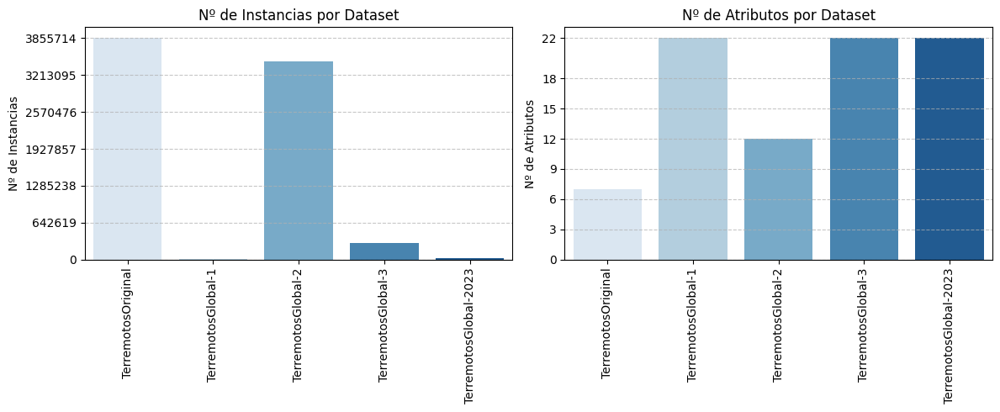

In [ ]:
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
sns.barplot(x='Nombre Dataset', y='Número de Instancias', hue='Nombre Dataset', data=tabla_info, palette=obtener_paleta_sns("Blues", len(tabla_info)))
plt.title('Nº de Instancias por Dataset')
plt.ylabel('Nº de Instancias')
plt.xlabel('')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.yticks(ticks=range(0, int(tabla_info['Número de Instancias'].max()) + 1, max(1, int(tabla_info['Número de Instancias'].max() // 6))),
           labels=range(0, int(tabla_info['Número de Instancias'].max()) + 1, max(1, int(tabla_info['Número de Instancias'].max() // 6))))
plt.xticks(rotation=90)

plt.subplot(1, 2, 2)
sns.barplot(x='Nombre Dataset', y='Número de Atributos', hue='Nombre Dataset', data=tabla_info, palette=obtener_paleta_sns("Blues", len(tabla_info)))
plt.title('Nº de Atributos por Dataset')
plt.ylabel('Nº de Atributos')
plt.xlabel('')
plt.xticks(rotation=90)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.yticks(np.linspace(0, tabla_info['Número de Atributos'].max(), num=8).astype(int))

plt.tight_layout()
plt.show()

---
## -- 1.2. Análisis de Atributos

En total, hay 29 atributos en los diferentes conjuntos de datos de terremotos, entre los cuales ocurren las siguientes coincidencias:
* <details>
  <summary>
    <b>Atributos comunes en todos los datasets:</b> 3
  </summary>
    <ul>
      <li>depth</li>
      <li>latitude</li>
      <li>longitude</li>
    </ul>
</details>
* <details>
  <summary>
    <b>Atributos comunes en al menos 4 datasets:</b> 5
  </summary>
    <ul>
      <li>id</li>
      <li>mag</li>
      <li>place</li>
      <li>status</li>
      <li>time</li>
    </ul>
</details>
* <details>
  <summary>
    <b>Atributos comunes en al menos 3 datasets:</b> 14
  </summary>
    <ul>
      <li>depthError</li>
      <li>dmin</li>
      <li>gap</li>
      <li>horizontalError</li>
      <li>locationSource</li>
      <li>magError</li>
      <li>magNst</li>
      <li>magSource</li>
      <li>magType</li>
      <li>net</li>
      <li>nst</li>
      <li>rms</li>
      <li>type</li>
      <li>updated</li>
    </ul>
</details>
* <details>
  <summary>
    <b>Atributos comunes en al menos 2 datasets:</b> 1
  </summary>
    <ul>
      <li>date</li>
    </ul>
</details>
* <details>
  <summary>
    <b>Atributos únicos a un solo dataset:</b> 6 (mayoría exclusiva del dataset "TerremotosGlobal-2"):
  </summary>
    <ul>
      <li>data_type</li>
      <li>hour</li>
      <li>magnitudo</li>
      <li>significance</li>
      <li>state</li>
      <li>tsunami</li>
    </ul>
</details>
---

A continuación, se detallan los atributos disponibles, organizados según su temática:
* **Atributos Relacionados con Características del Terremoto:**
  * **mag**: Magnitud del terremoto en la escala de Richter.
  * **magnitudo**: Magnitud del terremoto en la escala de Richter. (*)
  * **magType**: Tipo de medición de la magnitud.
  * **depth**:Profundidad del epicentro del terremoto en kilómetros.
  * **type**: Origen / Tipo del evento registrado.
  * **data_type**: Origen / Tipo del evento registrado. (*)
  * **tsunami**: Valor booleano que indica si el terremoto generó un tsunami.
  * **significance**: Valor que refleja la significancia del terremoto basado en su impacto y magnitud.
* **Atributos de Ubicación / Localización Geográfica:**
  * **latitude**: Latitud geográfica del epicentro del terremoto medida en grados.
  * **longitude**: Longitud geográfica del epicentro del terremoto medida en grados.
  * **place**: Ubicación textual del epicentro del terremoto.
  * **state**: Estado o región donde ocurrió el terremoto. (*)
* **Atributos Relacionados de Tiempo:**
  * **date**: Fecha en que ocurrió el terremoto.
  * **time**: Fecha y marca de tiempo en que ocurrió el terremoto.
  * **hour**: Hora específica en que ocurrió el terremoto. (*)
* **Atributos Relacionados con la Recogida de Datos:**
  * **id**: Identificador único asignado al terremoto.
  * **status**: Estado del análisis y recolección de los datos del terremoto.  (ie: reviewed, automatic...)
  * **updated**: Marca de tiempo que indica la última actualización de la información del terremoto.
  * **locationSource**: Fuente que proporcionó la ubicación del terremoto.
  * **magSource**: Fuente que proporcionó la información sobre la magnitud del terremoto.
  * **magNst**: Número de estaciones que registraron la magnitud del evento.
  * **net**: Código de la red que registró el terremoto.
  * **nst**: Número de estaciones que reportaron datos sobre el terremoto.
* **Atributos Relacionados con la Calidad de los Datos:**
  * **depthError**: Error estimado en la medición de la profundidad del epicentro.
  * **magError**: Error estimado en la medición de la magnitud del terremoto.
  * **gap**: Grados de variación en la localización del terremoto.
  * **dmin**: Distancia mínima entre el epicentro del terremoto y la estación de observación más cercana.
  * **rms**: Error cuadrático medio de la amplitud del espectro del terremoto, mide la variabilidad de las amplitudes de las ondas sísmicas.

In [ ]:
datasets = [datasetOriginal, datasetGlobal_1, datasetGlobal_2, datasetGlobal_3, datasetGlobal_4]

In [ ]:
generar_tabla_coincidencias(datasets, ['TerremotosOriginal', 'TerremotosGlobal-1', 'TerremotosGlobal-2', 'TerremotosGlobal-3', 'TerremotosGlobal-2023'])

,depth,latitude,longitude,id,mag,place,status,time,depthError,dmin,gap,horizontalError,locationSource,magError
TerremotosOriginal,X,X,X,X,X,,,,,,,,,
TerremotosGlobal-1,X,X,X,X,X,X,X,X,X,X,X,X,X,X
TerremotosGlobal-2,X,X,X,,,X,X,X,,,,,,
TerremotosGlobal-3,X,X,X,X,X,X,X,X,X,X,X,X,X,X
TerremotosGlobal-2023,X,X,X,X,X,X,X,X,X,X,X,X,X,X


,magNst,magSource,magType,net,nst,rms,type,updated,date,data_type,hour,magnitudo,significance,state,tsunami
TerremotosOriginal,,,,,,,,,X,,X,,,,
TerremotosGlobal-1,X,X,X,X,X,X,X,X,,,,,,,
TerremotosGlobal-2,,,,,,,,,X,X,,X,X,X,X
TerremotosGlobal-3,X,X,X,X,X,X,X,X,,,,,,,
TerremotosGlobal-2023,X,X,X,X,X,X,X,X,,,,,,,


In [ ]:
generar_tabla_resultados(datasets, ['TerremotosOriginal', 'TerremotosGlobal-1', 'TerremotosGlobal-2', 'TerremotosGlobal-3', 'TerremotosGlobal-2023'])

,depth,latitude,longitude,id,mag,place,status,time,depthError,dmin,gap,horizontalError,locationSource,magError
TerremotosOriginal,6.0,34.189835,-117.588,ci12317071,1.7,,,,,,,,,
TerremotosGlobal-1,4.2,38.16,-118.209,nn00826538,0.6,"27 km SSW of Mina, Nevada",automatic,2021-10-24T07:46:44.980Z,36.0,0.123,171.25,NaN,nn,0.37
TerremotosGlobal-2,30.1,61.7302,-149.6692,,,"12 km NNW of Meadow Lakes, Alaska",reviewed,631153353990,,,,,,
TerremotosGlobal-3,10.0,41.805,79.8675,us6000jrt9,5.0,"77 km NNW of Aksu, China",reviewed,2023-02-26T23:58:05.052Z,1.897,1.293,91.0,6.59,us,0.078
TerremotosGlobal-2023,82.77,52.0999,178.5218,us7000j5a1,3.1,"Rat Islands, Aleutian Islands, Alaska",reviewed,2023-01-01T00:49:25.294Z,21.213,0.87,139.0,8.46,us,0.097


,magNst,magSource,magType,net,nst,rms,type,updated,date,data_type,hour,magnitudo,significance,state,tsunami
TerremotosOriginal,,,,,,,,,1973-01-01,,0,,,,
TerremotosGlobal-1,5.0,nn,ml,nn,9.0,0.0948,earthquake,2021-10-24T07:50:24.747Z,,,,,,,
TerremotosGlobal-2,,,,,,,,,1990-01-01 00:22:33.990000+00:00,earthquake,,2.5,96,Alaska,0
TerremotosGlobal-3,52.0,us,mb,us,46.0,0.8,earthquake,2023-02-27T00:11:38.040Z,,,,,,,
TerremotosGlobal-2023,14.0,us,ml,us,14.0,0.18,earthquake,2023-03-11T22:51:52.040Z,,,,,,,


---
## -- 1.3. Análisis en Profundidad de Atributos


### --- 1.3.1. Atributos "date", "hour" y "time"

A partir del análisis de las variables de fecha y hora, se han identificado las siguientes observaciones:
* **Relación entre los atributos "date" y hour":**
  * En el conjunto de datos "datasetOriginal", la columna "date" muestra fechas en un formato estándar (YYYY-MM-DD), mientras que la columna "hour" se presenta como un entero que representa la hora en formato de 24 horas.
* **Consistencia en el formato del atributo "time":**
  * En la mayoría de los conjuntos de datos, esta variable se presenta en un formato estándar "ISO 8601" (YYYY-MM-DDTHH:MM:SS.sssZ), que incluye tanto la fecha como la hora con 3 milisegundos de exactitud, junto con la información de zona horaria.
  * En el caso del conjunto de datos "datasetGlobal_2", los valores de "time" están en un formato numérico que representa la hora en milisegundos, lo que resulta redundante al existir una columna en ese mismo dataset que indica la fecha y hora del evento sísmico ("date").

In [ ]:
# Transformar 'time' del conjunto de datos "datasetGlobal_2" a milisegundos
global_2_combined = pd.concat([
        datasetGlobal_2[['time']].head(),
        pd.to_datetime(datasetGlobal_2['time'].head(), unit='ms').dt.strftime('%Y-%m-%d %H:%M:%S.%f').rename('time_transformado'),
        datasetGlobal_2['date'].head()], axis=1)

print(BOLD_ON + "datasetOriginal:" + BOLD_OFF + "\n",   datasetOriginal[['date', 'hour']].head())
print("\n" + BOLD_ON + "datasetGlobal_1:" + BOLD_OFF + "\n", datasetGlobal_1[['time']].head())
print("\n" + BOLD_ON + "datasetGlobal_2:" + BOLD_OFF + "\n", global_2_combined)
print("\n" + BOLD_ON + "datasetGlobal_3:" + BOLD_OFF + "\n", datasetGlobal_3[['time']].head())
print("\n" + BOLD_ON + "datasetGlobal_4:" + BOLD_OFF + "\n", datasetGlobal_4[['time']].head())

datasetOriginal:
          date  hour
0  1973-01-01     0
1  1973-01-01     3
2  1973-01-01     4
3  1973-01-01     5
4  1973-01-01     7

datasetGlobal_1:
                        time
0  2021-10-24T07:46:44.980Z
1  2021-10-24T07:43:48.041Z
2  2021-10-24T07:41:52.946Z
3  2021-10-24T07:15:04.860Z
4  2021-10-24T07:09:17.330Z

datasetGlobal_2:
            time           time_transformado                              date
0  631153353990  1990-01-01 00:22:33.990000  1990-01-01 00:22:33.990000+00:00
1  631153491210  1990-01-01 00:24:51.210000  1990-01-01 00:24:51.210000+00:00
2  631154083450  1990-01-01 00:34:43.450000  1990-01-01 00:34:43.450000+00:00
3  631155512130  1990-01-01 00:58:32.130000  1990-01-01 00:58:32.130000+00:00
4  631155824490  1990-01-01 01:03:44.490000  1990-01-01 01:03:44.490000+00:00

datasetGlobal_3:
                        time
0  2023-02-26T23:58:05.052Z
1  2023-02-26T23:33:17.641Z
2  2023-02-26T21:42:14.541Z
3  2023-02-26T21:35:01.303Z
4  2023-02-26T18:58:54.828Z



### --- 1.3.2. Atributos "mag" y "magnitudo"


* Ambos atributos representan la misma variable al poseer una gran similitud en cuanto a nombre, descripción y rango de valores.
* Adicionalmente, se encontraron valores negativos en el conjunto de datos. Dado que las magnitudes de los terremotos no pueden ser negativas, se considerará la eliminación de todos los valores negativos y ceros, ya que podrían deberse a errores en la recolección de datos.

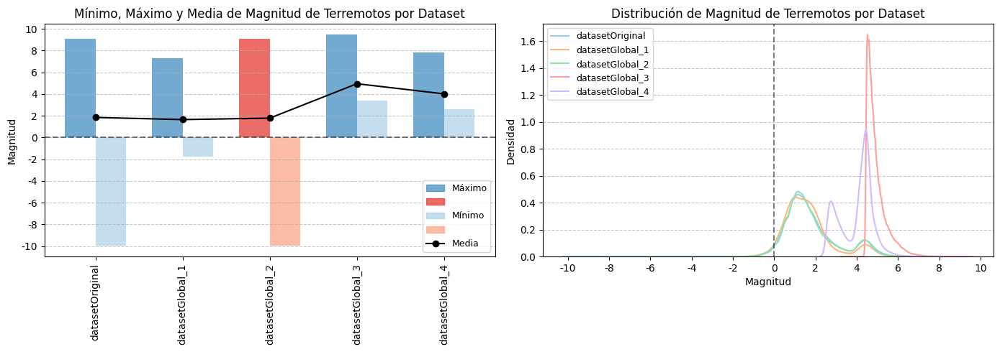

In [ ]:
dataset_names = ['datasetOriginal', 'datasetGlobal_1', 'datasetGlobal_2', 'datasetGlobal_3', 'datasetGlobal_4']
mag_columns = ['mag', 'mag', 'magnitudo', 'mag', 'mag']

# Cálculo de estadísticas (mínimo, máximo, media) por dataset
results = [
    {
        'type': name,
        'min': dataset[mag_col].min(),
        'max': dataset[mag_col].max(),
        'mean': dataset[mag_col].mean()
    }
    for dataset, name, mag_col in zip(datasets, dataset_names, mag_columns)
]
combined_dataset = pd.DataFrame(results)

colors = sns.color_palette("pastel", len(datasets))

# Gráfico Mínimo, Máximo y Media de Magnitud de Terremotos por Dataset
plt.figure(figsize=(14, 5))
plt.subplot(1, 2, 1)

for i, row in combined_dataset.iterrows():
        color_max = colors_red[1] if row['type'] == 'datasetGlobal_2' else colors_blue[1]
        color_min = colors_red[0] if row['type'] == 'datasetGlobal_2' else colors_blue[0]

        plt.bar(i - 0.35/2, row['max'], width=0.35, color=color_max, label='Máximo' if i == 2 else "", alpha=0.7)
        plt.bar(i + 0.35/2, row['min'], width=0.35, color=color_min, label='Mínimo' if i == 2 else "", alpha=0.7)

plt.plot(np.arange(len(combined_dataset['type'])), combined_dataset['mean'], marker='o', color='black', label='Media', zorder=5)

plt.title('Mínimo, Máximo y Media de Magnitud de Terremotos por Dataset')
plt.xlabel('')
plt.ylabel('Magnitud')
plt.xticks(np.arange(len(combined_dataset['type'])), combined_dataset['type'], rotation=90)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.axhline(y=0, linestyle='--', color="black", alpha=0.5)
plt.legend(
    handles=[
        plt.Rectangle((0, 0), 1, 1, color=colors_blue[1], alpha=0.7),
        plt.Rectangle((0, 0), 1, 1, color=colors_red[1], alpha=0.7),
        plt.Rectangle((0, 0), 1, 1, color=colors_blue[0], alpha=0.7),
        plt.Rectangle((0, 0), 1, 1, color=colors_red[0], alpha=0.7),
        plt.Line2D([0], [0], marker='o', color='black', linestyle='-', label='Media', markerfacecolor='black'),
    ],
    labels=['Máximo', '', 'Mínimo', '', 'Media'],
    fontsize=9
)

plt.yticks(ticks=np.linspace(-10, 10, num=11).astype(int), labels=np.linspace(-10, 10, num=11).astype(int))

# Gráfico de distribución KDE
plt.subplot(1, 2, 2)
for i, (dataset, name, mag_col) in enumerate(zip(datasets, dataset_names, mag_columns)):
    sns.kdeplot(dataset[mag_col], bw_adjust=1.2, label=name, color=colors[i])

plt.axvline(x=0, linestyle='--', color="black", alpha=0.5)
plt.title('Distribución de Magnitud de Terremotos por Dataset')
plt.xlabel('Magnitud')
plt.ylabel('Densidad')
plt.legend(fontsize=9, loc="upper left")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.xticks(ticks=np.linspace(-10, 10, num=11).astype(int), labels=np.linspace(-10, 10, num=11).astype(int))

plt.tight_layout()
plt.show()

### --- 1.3.3. Atributos "type" y "data_type"


* Inicialmente, se observó que los atributos "type" y "data_type" parecían ser equivalentes debido a sus descripciones similares. Esta equivalencia fue confirmada al analizar los valores únicos de cada columna. Como resultado, se decidió fusionar ambos atributos en uno solo, aplicando además una estandarización manual a ciertos valores (ie: "rockslide" y "rock slide"). También se considera necesario normalizar todos los valores a minúsculas para eliminar para evitar duplicaciones de valores (ie: "Ice Quake" e "ice quake").
* Por otro lado, se descubrió la existencia de los valores "not reported" y "other event", que se consideran como datos faltantes o no disponibles ("NaN").

In [ ]:
datasets = pd.concat(
    [datasetOriginal, datasetGlobal_1, datasetGlobal_2, datasetGlobal_3, datasetGlobal_4],
    ignore_index=True
)

In [ ]:
generar_tabla_coincidencias_valores(datasets, ['type', 'data_type'], 2)
print("-" * 50)
print("\n" + BOLD_ON + "Atributos 'type' y 'data_type' normalizados:" + BOLD_OFF)
generar_tabla_coincidencias_valores(datasets, ['type', 'data_type'], 2, normalizar=True)

,explosion,mining explosion,nuclear explosion,quarry blast,earthquake,landslide,rock burst,other event,mine collapse,ice quake,volcanic eruption,Rock Slide,rockslide
type,X,X,X,X,X,X,X,X,X,X,X,,
data_type,X,X,X,X,X,X,X,X,X,X,X,X,X


,Landslide,sonic boom,accidental explosion,experimental explosion,snow avalanche,induced or triggered event,quarry,not reported,acoustic noise,Ice Quake,collapse,meteorite,chemical explosion
type,X,,,,,,,,,,,,
data_type,,X,X,X,X,X,X,X,X,X,X,X,X



--------------------------------------------------

Atributos 'type' y 'data_type' normalizados:


,explosion,mining explosion,nuclear explosion,quarry blast,earthquake,landslide,rock burst,other event,mine collapse,ice quake,volcanic eruption,rockslide
type,X,X,X,X,X,X,X,X,X,X,X,
data_type,X,X,X,X,X,X,X,X,X,X,X,X


,sonic boom,accidental explosion,rock slide,experimental explosion,snow avalanche,induced or triggered event,quarry,not reported,acoustic noise,collapse,meteorite,chemical explosion
type,,,,,,,,,,,,
data_type,X,X,X,X,X,X,X,X,X,X,X,X


### --- 1.3.4. Atributos "place" y "state"


* En el conjunto de datos "terremotosGlobal-2", se confirma que su columna exclusiva "state" está siempre incluido en su otra columna "place", salvo en el caso de "California", donde se presenta como "CA". Esto sugiere la necesidad de ajustar los nombres de los valores de los atributos para asegurar que la información sea uniforme y fácil de interpretar en todo el conjunto de datos, eliminando la columna exclusiva "state" la cual es, además, menos descriptiva.

In [ ]:
# Filas donde "state" no es NaN y "state" no está en "place"
rows_without_state = datasetGlobal_2[
    datasetGlobal_2['state'].notna() &
    ~datasetGlobal_2.apply(lambda row: row['state'] in row['place'], axis=1)
]

if not rows_without_state.empty:
    print(BOLD_ON + "Filas donde la columna 'place' no contiene 'state':" + BOLD_OFF)
    print(rows_without_state[['state', 'place']])

print("\n" + BOLD_ON + "Ocurrencias de 'California' en 'state':\t" + BOLD_OFF + str(rows_without_state['state'].str.contains("California").sum()))
print(BOLD_ON + "Ocurrencias de 'CA' en 'place':\t\t" + BOLD_OFF + str(rows_without_state['place'].str.contains("CA").sum()))

print("\n" + BOLD_ON + "Ocurrencias de 'California' en 'place':\t" + BOLD_OFF + str(rows_without_state['place'].str.contains("California").sum()))
print(BOLD_ON + "Ocurrencias de 'CA' en 'state':\t\t" + BOLD_OFF + str(rows_without_state['state'].str.contains("CA").sum()))

Filas donde la columna 'place' no contiene 'state':
              state                          place
4        California         16km N of Fillmore, CA
5        California         16km N of Fillmore, CA
14       California         16km N of Fillmore, CA
27       California      20km ENE of Coachella, CA
29       California         15km NE of Thermal, CA
...             ...                            ...
3445740  California        6 km NNW of Cabazon, CA
3445741  California        4 km SW of Redlands, CA
3445743  California        16 km ESE of Julian, CA
3445745  California  0 km SW of Universal City, CA
3445749  California             7 km W of Cobb, CA

[491392 rows x 2 columns]

Ocurrencias de 'California' en 'state':	491392
Ocurrencias de 'CA' en 'place':		491392

Ocurrencias de 'California' en 'place':	0
Ocurrencias de 'CA' en 'state':		0


### --- 1.3.5. Atributos "magSource" y "locationSource"

* Aunque inicialmente los atributos "magSource" y "locationSource" se consideraron equivalentes debido a las similitudes en sus valores únicos, al profundizar en su aparición por pares se encontraron discrepancias significativas entre ambas columnas para la misma instancia. Esto indica que, aunque en muchos casos los valores coinciden, "magSource" y "locationSource" no deben intercambiarse, ya que representan múltiples fuentes de información que no siempre están alineadas.
* Adicionalmente, durante el análisis se identificaron varios valores en ambas variables que comenzaban con el prefijo "us_", lo que sugiere que podrían ser versiones específicas de las ubicaciones. Al llevar a cabo un análisis más exhaustivo, se observó que había un número significativamente menor de contrapartes para estos valores, lo que lleva a considerar la posibilidad de unir estos atributos, ya que dicha unificación podría realizarse sin perder información crítica.
* Por otro lado, se considera necesario normalizar todos los valores de ambos atributos para evitar duplicados.

In [ ]:
generar_tabla_coincidencias_valores(datasets, ['locationSource', 'magSource'], 7, normalizar=True)

,qui,hdc,iscgemsup,uu,ak,teh,grf,us_teh,tul,bji,uw,gen,pre,iscgem,dda,buc,casc,pr,nn,pas,aust,gii,ath,nc,av,tir,ci,but,brk,irsa,ldg
locationSource,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X
magSource,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X


,us,mdd,jma,official,dja,rsnc,hv,pt,us_guc,tx,wel,ucr,rspr,mb,ott,rom,us_wel,us_rsnc,str,the,dhmr,lim,pal,zag,upa,aro,pgc,csem,guc,car,se
locationSource,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X
magSource,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X


,dmn,unm,ld,tap,fdf,isk,us_pgc,snet,nm,aeic,aacse,trn,gcmt,ok,sja,pdg,ren,u,ushis,ber,tri,gw,rog,us_buc,bykl,ags,dos,h,s,zur,pmr
locationSource,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,,,,X,X,X,,X,X,X,
magSource,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,,,,X,X,X,,,,X,,,,X


,duputel,mox,mmt,gs,bou,mpr,sea,kba,mat,wy,vic,us_trn,bns,cll,par,bud,dnk,01020,spec,a,ttg,e,snm,oth,jon,spe,uh,bgs,st,wes,dg
locationSource,,,,,X,X,X,,,,,X,,,,,X,,X,X,,X,X,,,X,,X,,X,
magSource,X,X,X,X,,,,X,X,X,X,,X,X,X,X,,X,,,X,,,X,X,,X,,X,,X


,apy,too,fur,sjg,bra,ryd,us_lim,c,alg,01009,bar,yel,ell,us_ath,us_sja,rot,dw,us_gcmt,hht,sdd,bas,gl,th,ntt,gcg,01000,nic,us_unm,mel,pivs,san
locationSource,,,,,,,X,X,X,,,,,X,X,,,,,X,,X,,,,,X,X,X,X,
magSource,X,X,X,X,X,X,,,,X,X,X,X,,,X,X,X,X,,X,,X,X,X,X,,,,,X


,cfr,nao,ssnc,gr,kmi,g,lju,zamg,epb,vka,mos,cdmg,ric,kj,war,sjr,sg,tag,som,gol,uvc,01023,aei,p,sko,dor,sc,isc,b,hrv,hvo
locationSource,,,X,,,X,,,,,,,,,X,,,,,,,,X,X,X,,,,X,,
magSource,X,X,,X,X,,X,X,X,X,X,X,X,X,,X,X,X,X,X,X,X,,,,X,X,X,,X,X


,dou,w,ag,ppt,woo,rey,doe,o,sof,jm,esm,slm,slc,fbb,bul,us_the,brg,lsz,pmg,vie,hrn,jer,ecx,us_thr,nied,klg,abe,nqt,upp,beo,grc,thr
locationSource,,X,X,,,X,X,X,X,,,,X,X,,X,,,,,,,X,X,,,,,,X,,X
magSource,X,,,X,X,,,,,X,X,X,,,X,,X,X,X,X,X,X,,,X,X,X,X,X,,X,


In [ ]:
# Filas donde 'magSource' y 'locationSource' no coinciden
non_matching_sources = datasets[
    datasets['magSource'].notna() &
    datasets['locationSource'].notna() &
    (datasets['magSource'] != datasets['locationSource'])
]

print(BOLD_ON + "Instancias donde 'magSource' y 'locationSource' no coinciden:" + BOLD_OFF + "[" + str(len(non_matching_sources)) + "]")
print(non_matching_sources[['magSource', 'locationSource']])

discrepancy_counts = (
    non_matching_sources
    .groupby(['magSource', 'locationSource'], as_index=False)
    .size()
    .rename(columns={'size': 'Nº Discrepancias'})
    .sort_values(by='Nº Discrepancias', ascending=False)
)

print("\n" + BOLD_ON + "Nº de discrepancias más comunes por pares:" + BOLD_OFF)
print(discrepancy_counts.head(10))

Instancias donde 'magSource' y 'locationSource' no coinciden:[35978]
        magSource locationSource
3857571       guc             us
3858418       guc             us
3859329       guc             us
3860395       guc             us
3862167       guc             us
...           ...            ...
7619747       guc             us
7619848       guc             us
7620210       guc             us
7620304       guc             us
7620832       guc             us

[35978 rows x 2 columns]

Nº de discrepancias más comunes por pares:
    magSource locationSource  Nº Discrepancias
131       hrv             us             19476
81       gcmt             us              8125
268        us            guc              1035
165      nied             us               643
92        guc             us               539
163        nc             us               479
335        us            wel               402
236        us           aeic               355
318        us            unm              

In [ ]:
location_us_values = datasets['locationSource'].value_counts()
magSource_us_values = datasets['magSource'].value_counts()

location_us_values = location_us_values[location_us_values.index.str.startswith('us_')]
magSource_us_values = magSource_us_values[magSource_us_values.index.str.startswith('us_')]

def contar_contrapartes(us_value, source_counts):
    counterpart = us_value.replace('us_', '')
    count_us = source_counts.get(us_value, 0)
    count_counterpart = source_counts.get(counterpart, 0)
    return f"{us_value}: {count_us} \t | {counterpart}: {count_counterpart}"

location_results = location_us_values.index.map(lambda us_value: contar_contrapartes(us_value, datasets['locationSource'].value_counts()))
magSource_results = magSource_us_values.index.map(lambda us_value: contar_contrapartes(us_value, datasets['magSource'].value_counts()))

print(BOLD_ON + "Conteo de valores y su contraparte en 'locationSource':" + BOLD_OFF)
print("\n".join(location_results))

print("\n" + BOLD_ON + "\nConteo de valores y su contraparte en 'magSource':" + BOLD_OFF)
print("\n".join(magSource_results))

Conteo de valores y su contraparte en 'locationSource':
us_wel: 23 	 | wel: 988
us_guc: 20 	 | guc: 1338
us_the: 11 	 | the: 93
us_unm: 8 	 | unm: 545
us_sja: 4 	 | sja: 59
us_teh: 2 	 | teh: 265
us_thr: 2 	 | thr: 144
us_ath: 1 	 | ath: 303
us_buc: 1 	 | buc: 24
us_pgc: 1 	 | pgc: 214
us_trn: 1 	 | trn: 53
us_lim: 1 	 | lim: 68
us_rsnc: 1 	 | rsnc: 24


Conteo de valores y su contraparte en 'magSource':
us_pgc: 6 	 | pgc: 237
us_gcmt: 4 	 | gcmt: 8657
us_wel: 2 	 | wel: 579
us_guc: 1 	 | guc: 738
us_rsnc: 1 	 | rsnc: 14
us_teh: 1 	 | teh: 7


### --- 1.3.6. Atributo "status"

*  El atributo "status" presenta un problema de falta de estandarización en sus valores, necesitando una normalización a minúsculas.

In [ ]:
generar_tabla_coincidencias_valores(datasets, ['status'], 1)
print("-" * 50)
print("\n" + BOLD_ON + "Atributo 'status' normalizado:" + BOLD_OFF)
generar_tabla_coincidencias_valores(datasets, ['status'], 1, normalizar = True)

,manual,AUTOMATIC,automatic,reviewed,MANUAL,REVIEWED
status,X,X,X,X,X,X



--------------------------------------------------

Atributo 'status' normalizado:


,automatic,reviewed,manual
status,X,X,X


---
## -- 1.4. Transformación y Estandarización de Atributos

In [ ]:
inicio = time()

datasets = [datasetOriginal, datasetGlobal_1, datasetGlobal_2, datasetGlobal_3, datasetGlobal_4]

# 1. Transformaciones específicas de fecha y hora
for dataset in [datasetGlobal_1, datasetGlobal_3, datasetGlobal_4]:
    if 'time' in dataset.columns:
        dataset[['date_new', 'time_new']] = dataset['time'].str.split('T', expand=True)
        dataset['time_new'] = dataset['time_new'].str.replace('Z', '')

if 'date' in datasetGlobal_2.columns:
    datasetGlobal_2[['date_new', 'time_new']] = datasetGlobal_2['date'].str.split(' ', expand=True)

if 'date' in datasetOriginal.columns and 'hour' in datasetOriginal.columns:
    datasetOriginal['date_new'] = datasetOriginal['date']
    datasetOriginal['time_new'] = pd.to_datetime(datasetOriginal['hour'], format='%H').dt.strftime('%H:%M:%S.000')

if 'time_new' in datasetGlobal_2.columns:
    datasetGlobal_2['time_new'] = datasetGlobal_2['time_new'].str.split('+').str[0].str[:12]

# 2. General: Estandarizar y ajustar columnas en todos los datasets
for dataset in datasets:
    # Copiar "magnitudo" en "mag" y eliminar la columna "magnitudo"
    if 'magnitudo' in dataset.columns:
        dataset['mag'] = dataset.pop('magnitudo')

    # Renombrar la columna 'data_type' a 'type' SOLO en datasetGlobal_2
    if dataset is datasetGlobal_2 and 'data_type' in dataset.columns:
        dataset.rename(columns={'data_type': 'type'}, inplace=True)

    # Eliminar columnas 'date', 'hour', 'time' si existen
    dataset.drop(columns=[col for col in ['date', 'hour', 'time'] if col in dataset.columns], inplace=True, errors='ignore')

    # Renombrar "date_new" y "time_new" a "date" y "time"
    if 'date_new' in dataset.columns:
        dataset.rename(columns={'date_new': 'date'}, inplace=True)
    if 'time_new' in dataset.columns:
        dataset.rename(columns={'time_new': 'time'}, inplace=True)

    # Eliminar columna 'state' si existe
    if 'state' in dataset.columns:
        dataset.drop(columns=['state'], inplace=True)

    # Ajustar el nombre del lugar en la columna 'place' si existe
    if 'place' in dataset.columns:
        dataset['place'] = dataset['place'].str.replace(' CA', ' California')

    # Estandarizar 'status' a minúsculas
    if 'status' in dataset.columns:
        dataset['status'] = dataset['status'].str.lower()

    # Estandarizar 'type' y reemplazar valores
    if 'type' in dataset.columns:
        dataset['type'] = dataset['type'].str.lower()
        dataset['type'] = dataset['type'].str.replace('rockslide', 'rock slide').replace(['not reported', 'other event'], np.nan)

    # Estandarizar 'magType' a minúsculas
    if 'magType' in dataset.columns:
        dataset['magType'] = dataset['magType'].str.lower()

    # Eliminar prefijo 'us_' en 'locationSource' y 'magSource' si existen
    for col in ['locationSource', 'magSource']:
        if col in dataset.columns:
            dataset[col] = dataset[col].str.replace('us_', '', regex=True)

# Eliminar las instancias con magnitud menor o igual a 0
datasetOriginal = datasetOriginal[datasetOriginal['mag'] > 0]
datasetGlobal_1 = datasetGlobal_1[datasetGlobal_1['mag'] > 0]
datasetGlobal_2 = datasetGlobal_2[datasetGlobal_2['mag'] > 0]
datasetGlobal_3 = datasetGlobal_3[datasetGlobal_3['mag'] > 0]
datasetGlobal_4 = datasetGlobal_4[datasetGlobal_4['mag'] > 0]

tiempoLimpiezaPandas = time() - inicio

In [ ]:
generar_tabla_coincidencias([datasetOriginal, datasetGlobal_1, datasetGlobal_2, datasetGlobal_3, datasetGlobal_4],
                            ['TerremotosOriginal', 'TerremotosGlobal-1', 'TerremotosGlobal-2', 'TerremotosGlobal-3', 'TerremotosGlobal-2023'])

,date,depth,latitude,longitude,mag,time,id,place,status,type,depthError,dmin
TerremotosOriginal,X,X,X,X,X,X,X,,,,,
TerremotosGlobal-1,X,X,X,X,X,X,X,X,X,X,X,X
TerremotosGlobal-2,X,X,X,X,X,X,,X,X,X,,
TerremotosGlobal-3,X,X,X,X,X,X,X,X,X,X,X,X
TerremotosGlobal-2023,X,X,X,X,X,X,X,X,X,X,X,X


,gap,horizontalError,locationSource,magError,magNst,magSource,magType,net,nst,rms,updated,significance,tsunami
TerremotosOriginal,,,,,,,,,,,,,
TerremotosGlobal-1,X,X,X,X,X,X,X,X,X,X,X,,
TerremotosGlobal-2,,,,,,,,,,,,X,X
TerremotosGlobal-3,X,X,X,X,X,X,X,X,X,X,X,,
TerremotosGlobal-2023,X,X,X,X,X,X,X,X,X,X,X,,


In [ ]:
generar_tabla_resultados([datasetOriginal, datasetGlobal_1, datasetGlobal_2, datasetGlobal_3, datasetGlobal_4],
                            ['TerremotosOriginal', 'TerremotosGlobal-1', 'TerremotosGlobal-2', 'TerremotosGlobal-3', 'TerremotosGlobal-2023'])

,date,depth,latitude,longitude,mag,time,id,place,status,type,depthError,dmin
TerremotosOriginal,1973-01-01,6.0,34.189835,-117.588,1.7,00:00:00.000,ci12317071,,,,,
TerremotosGlobal-1,2021-10-24,4.2,38.16,-118.209,0.6,07:46:44.980,nn00826538,"27 km SSW of Mina, Nevada",automatic,earthquake,36.0,0.123
TerremotosGlobal-2,1990-01-01,30.1,61.7302,-149.6692,2.5,00:22:33.990,,"12 km NNW of Meadow Lakes, Alaska",reviewed,earthquake,,
TerremotosGlobal-3,2023-02-26,10.0,41.805,79.8675,5.0,23:58:05.052,us6000jrt9,"77 km NNW of Aksu, China",reviewed,earthquake,1.897,1.293
TerremotosGlobal-2023,2023-01-01,82.77,52.0999,178.5218,3.1,00:49:25.294,us7000j5a1,"Rat Islands, Aleutian Islands, Alaska",reviewed,earthquake,21.213,0.87


,gap,horizontalError,locationSource,magError,magNst,magSource,magType,net,nst,rms,updated,significance,tsunami
TerremotosOriginal,,,,,,,,,,,,,
TerremotosGlobal-1,171.25,NaN,nn,0.37,5.0,nn,ml,nn,9.0,0.0948,2021-10-24T07:50:24.747Z,,
TerremotosGlobal-2,,,,,,,,,,,,96,0
TerremotosGlobal-3,91.0,6.59,us,0.078,52.0,us,mb,us,46.0,0.8,2023-02-27T00:11:38.040Z,,
TerremotosGlobal-2023,139.0,8.46,us,0.097,14.0,us,ml,us,14.0,0.18,2023-03-11T22:51:52.040Z,,


In [ ]:
# Guardar los datasets con el sufijo '_CLEAN'
datasetOriginal.to_csv('TerremotosOriginal_clean.csv', index=False)
datasetGlobal_1.to_csv('TerremotosGlobal-1_clean.csv', index=False)
datasetGlobal_2.to_csv('TerremotosGlobal-2_clean.csv', index=False)
datasetGlobal_3.to_csv('TerremotosGlobal-3_clean.csv', index=False)
datasetGlobal_4.to_csv('TerremotosGlobal-2023_clean.csv', index=False)

---
## -- 1.5. Unión de Datasets

In [ ]:
datasetOriginal = pd.read_csv('TerremotosOriginal_clean.csv')
datasetGlobal_1 = pd.read_csv('TerremotosGlobal-1_clean.csv')
datasetGlobal_2 = pd.read_csv('TerremotosGlobal-2_clean.csv')
datasetGlobal_3 = pd.read_csv('TerremotosGlobal-3_clean.csv')
datasetGlobal_4 = pd.read_csv('TerremotosGlobal-2023_clean.csv')

In [ ]:
inicio = time()

combined_dataset = pd.concat(
    [datasetOriginal, datasetGlobal_1, datasetGlobal_2, datasetGlobal_3, datasetGlobal_4],
    ignore_index=True
).drop(columns=['id', 'updated'])

combined_dataset.reset_index(drop=True, inplace=True)

tiempoMergePandas = time() - inicio

In [ ]:
# Número de instancias antes del agrupamiento
nulos_antes = combined_dataset.isnull().sum().sort_values(ascending=False)
num_instancias_antes = combined_dataset.shape[0]

# Agrupar por columnas específicas y rellenar nulos
combined_dataset = combined_dataset.groupby(['date', 'mag', 'latitude', 'longitude'], as_index=False).first()

# Número de instancias después del agrupamiento
num_instancias_despues = combined_dataset.shape[0]
nulos_despues = combined_dataset.isnull().sum()

# Comparación nulos antes y después del agrupamiento
nulos_comparacion = pd.DataFrame({
    ' ': nulos_antes.index,
    'Antes del Agrupamiento': nulos_antes.values,
    'Después del Agrupamiento': nulos_despues.reindex(nulos_antes.index, fill_value=0).values
}).set_index(' ')

display(nulos_comparacion)

,Antes del Agrupamiento,Después del Agrupamiento
,,
horizontalError,7306610,5224367
dmin,7300011,5217772
magError,7285238,5202961
nst,7276157,5193760
gap,7225124,5142888
depthError,7220082,5137852
magNst,7171649,5089403
rms,7131535,5049313
magType,7083219,5001037


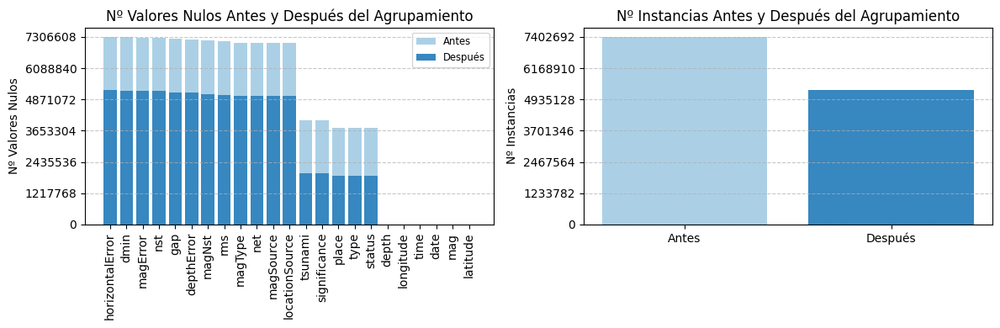

In [ ]:
# Configurar la figura con dos subgráficas
plt.figure(figsize=(12, 4))

# Gráfica comparación de Nulos
plt.subplot(1, 2, 1)
plt.bar(nulos_comparacion.index, nulos_comparacion['Antes del Agrupamiento'],
        color=colors_blue[0], alpha=1, label='Antes')
plt.bar(nulos_comparacion.index, nulos_comparacion['Después del Agrupamiento'],
        color=colors_blue[1], alpha=1, label='Después')
plt.title('Nº Valores Nulos Antes y Después del Agrupamiento')
plt.ylabel('Nº Valores Nulos')
plt.xticks(rotation=90)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(fontsize='small')

max_nulos = int(nulos_comparacion['Antes del Agrupamiento'].max())
plt.yticks(ticks=range(0, max_nulos + 1, max(1, max_nulos // 6)),
           labels=range(0, max_nulos + 1, max(1, max_nulos // 6)))

# Gráfica Número de Instancias
plt.subplot(1, 2, 2)
plt.bar(['Antes', 'Después'], [num_instancias_antes, num_instancias_despues],
        color=colors_blue, alpha=1)
plt.title('Nº Instancias Antes y Después del Agrupamiento')
plt.ylabel('Nº Instancias')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.yticks(ticks=range(0, num_instancias_antes + 1, max(1, num_instancias_antes // 6)),
           labels=range(0, num_instancias_antes + 1, max(1, num_instancias_antes // 6)))

plt.tight_layout()
plt.show()

In [ ]:
# Definir el nuevo orden de las columnas del dataset combinado (por 'date' y 'time')
first_columns = ['date', 'time', 'latitude', 'longitude', 'mag']
remaining_columns = combined_dataset.columns.difference(first_columns)
sorted_remaining_columns = combined_dataset[remaining_columns].notnull().sum().sort_values(ascending=False).index

new_order = first_columns + list(sorted_remaining_columns)
combined_dataset = combined_dataset[new_order]

combined_dataset.sort_values(by=['date', 'time'], inplace=True)
combined_dataset.reset_index(drop=True, inplace=True)

combined_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5317692 entries, 0 to 5317691
Data columns (total 23 columns):
 #   Column           Dtype  
---  ------           -----  
 0   date             object 
 1   time             object 
 2   latitude         float64
 3   longitude        float64
 4   mag              float64
 5   depth            float64
 6   status           object 
 7   type             object 
 8   place            object 
 9   significance     float64
 10  tsunami          float64
 11  locationSource   object 
 12  magSource        object 
 13  net              object 
 14  magType          object 
 15  rms              float64
 16  magNst           float64
 17  depthError       float64
 18  gap              float64
 19  nst              float64
 20  magError         float64
 21  dmin             float64
 22  horizontalError  float64
dtypes: float64(14), object(9)
memory usage: 933.1+ MB


In [ ]:
generar_tabla_resultados([combined_dataset], ['combined_dataset'])

,date,depth,depthError,dmin,gap,horizontalError,latitude,locationSource,longitude,mag,magError
combined_dataset,1906-01-02,15.0,4.9,NaN,NaN,NaN,45.386,iscgem,16.521,5.79,0.41


,magNst,magSource,magType,net,nst,place,rms,significance,status,time,tsunami,type
combined_dataset,NaN,iscgem,mw,iscgem,NaN,"4 km WNW of Sunja, Croatia",NaN,NaN,reviewed,04:26:27.250,NaN,earthquake


In [ ]:
combined_dataset.to_csv('TerremotosGlobal_combinados_clean.csv', index=False)

## -- 1.6. Comparativa Pandas y Dask

### --- 1.6.1. Limpieza y Unión de Datasets Dask

In [ ]:
inicio = time()

datasetOriginal_dask = dd.read_csv('TerremotosOriginal.csv', delimiter = ',')
datasetGlobal_1_dask = dd.read_csv('TerremotosGlobal-1.csv', delimiter=',')
datasetGlobal_2_dask = dd.read_csv('TerremotosGlobal-2.csv', delimiter=',')
datasetGlobal_3_dask = dd.read_csv('TerremotosGlobal-3.csv', delimiter=',')
datasetGlobal_4_dask = dd.read_csv('TerremotosGlobal-2023.csv', delimiter=',')

tiempoCargaDask = time() - inicio

In [ ]:
inicio = time()

datasets_dask = [datasetOriginal_dask, datasetGlobal_1_dask, datasetGlobal_2_dask, datasetGlobal_3_dask, datasetGlobal_4_dask]

# 1. Transformaciones específicas de fecha y hora
for dataset_dask in [datasetGlobal_1_dask, datasetGlobal_3_dask, datasetGlobal_4_dask]:
    if 'time' in dataset_dask.columns:
        # Usamos .map_partitions para aplicar la función a cada partición de Dask
        dataset_dask['date_new'] = dataset_dask['time'].map_partitions(lambda col: col.str.split('T').str[0])
        dataset_dask['time_new'] = dataset_dask['time'].map_partitions(lambda col: col.str.split('T').str[1].str.replace('Z', ''))

if 'date' in datasetGlobal_2_dask.columns:
    datasetGlobal_2_dask['date_new'] = datasetGlobal_2_dask['date'].map_partitions(lambda col: col.str.split(' ').str[0])
    datasetGlobal_2_dask['time_new'] = datasetGlobal_2_dask['date'].map_partitions(lambda col: col.str.split(' ').str[1])

if 'date' in datasetOriginal_dask.columns and 'hour' in datasetOriginal_dask.columns:
    datasetOriginal_dask['date_new'] = datasetOriginal_dask['date']
    datasetOriginal_dask['time_new'] = dd.to_datetime(datasetOriginal_dask['hour'], format='%H').dt.strftime('%H:%M:%S.000')

if 'time_new' in datasetGlobal_2_dask.columns:
    datasetGlobal_2_dask['time_new'] = datasetGlobal_2_dask['time_new'].map_partitions(lambda col: col.str.split('+').str[0].str[:12])

# 2. General: Estandarizar y ajustar columnas en todos los datasets
for dataset_dask in datasets_dask:
    # Copiar "magnitudo" en "mag" y eliminar la columna "magnitudo"
    if 'magnitudo' in dataset_dask.columns:
        dataset_dask['mag'] = dataset_dask.pop('magnitudo')

    # Renombrar la columna 'data_type' a 'type' SOLO en datasetGlobal_2_dask
    if dataset_dask is datasetGlobal_2_dask and 'data_type' in dataset_dask.columns:
        dataset_dask = dataset_dask.rename(columns={'data_type': 'type'})

    # Eliminar columnas 'date', 'hour', 'time' si existen
    dataset_dask = dataset_dask.drop(columns=[col for col in ['date', 'hour', 'time'] if col in dataset_dask.columns], errors='ignore')

    # Renombrar "date_new" y "time_new" a "date" y "time"
    if 'date_new' in dataset_dask.columns:
        dataset_dask = dataset_dask.rename(columns={'date_new': 'date'})
    if 'time_new' in dataset_dask.columns:
        dataset_dask = dataset_dask.rename(columns={'time_new': 'time'})

    # Eliminar columna 'state' si existe
    if 'state' in dataset_dask.columns:
        dataset_dask = dataset_dask.drop(columns=['state'])

    # Ajustar el nombre del lugar en la columna 'place' si existe
    if 'place' in dataset_dask.columns:
        dataset_dask['place'] = dataset_dask['place'].str.replace(' CA', ' California')

    # Estandarizar 'status' a minúsculas
    if 'status' in dataset_dask.columns:
        dataset_dask['status'] = dataset_dask['status'].str.lower()

    # Estandarizar 'type' y reemplazar valores
    if 'type' in dataset_dask.columns:
        dataset_dask['type'] = dataset_dask['type'].str.lower()
        dataset_dask['type'] = dataset_dask['type'].str.replace('rockslide', 'rock slide').replace(['not reported', 'other event'], None)

    # Estandarizar 'magType' a minúsculas
    if 'magType' in dataset_dask.columns:
        dataset_dask['magType'] = dataset_dask['magType'].str.lower()

    # Eliminar prefijo 'us_' en 'locationSource' y 'magSource' si existen
    for col in ['locationSource', 'magSource']:
        if col in dataset_dask.columns:
            dataset_dask[col] = dataset_dask[col].str.replace('us_', '', regex=True)

# Eliminar las instancias con magnitud menor o igual a 0
datasetOriginal_dask = datasetOriginal_dask[datasetOriginal_dask['mag'] > 0]
datasetGlobal_1_dask = datasetGlobal_1_dask[datasetGlobal_1_dask['mag'] > 0]
datasetGlobal_2_dask = datasetGlobal_2_dask[datasetGlobal_2_dask['mag'] > 0]
datasetGlobal_3_dask = datasetGlobal_3_dask[datasetGlobal_3_dask['mag'] > 0]
datasetGlobal_4_dask = datasetGlobal_4_dask[datasetGlobal_4_dask['mag'] > 0]

# Computar los resultados
datasetOriginal_dask = datasetOriginal_dask.compute()
datasetGlobal_1_dask = datasetGlobal_1_dask.compute()
datasetGlobal_2_dask = datasetGlobal_2_dask.compute()
datasetGlobal_3_dask = datasetGlobal_3_dask.compute()
datasetGlobal_4_dask = datasetGlobal_4_dask.compute()

tiempoLimpiezaDask = time() - inicio

In [ ]:
inicio = time()

combined_dataset_dask = dd.concat(
    [datasetOriginal_dask, datasetGlobal_1_dask, datasetGlobal_2_dask, datasetGlobal_3_dask, datasetGlobal_4_dask],
    ignore_index=True
).drop(columns=['id', 'updated'])

combined_dataset_dask = combined_dataset_dask.reset_index(drop=True)

combined_dataset_dask = combined_dataset_dask.compute()

tiempoMergeDask = time() - inicio

In [ ]:
datasetOriginal = pd.read_csv('TerremotosOriginal_clean.csv')
datasetOriginal_dask = dd.read_csv('TerremotosOriginal_clean.csv')

inicio = time()

print(datasetOriginal.query("depth < 10"))

tiempoBusquedaPandas = time() - inicio

inicio = time()

print(datasetOriginal_dask.query("depth < 10").compute())

tiempoBusquedaDask = time() - inicio

          latitude   longitude  depth   mag          id        date  \
0        34.189835 -117.588000  6.000  1.70  ci12317071  1973-01-01   
4        19.443666 -155.360840  7.302  1.85  hv19723167  1973-01-01   
13       33.629333 -117.347500  6.100  2.98   ci3320413  1973-01-02   
18       19.314833 -155.253170  7.041  1.93  hv19730002  1973-01-02   
19       19.326000 -155.204330  6.589  2.21  hv19730003  1973-01-02   
...            ...         ...    ...   ...         ...         ...   
3749272  33.374832 -116.866000  6.170  0.75  ci39900303  2021-12-31   
3749273  33.376000 -116.872330  6.350  0.93  ci39900295  2021-12-31   
3749274  33.377167 -116.871666  6.010  0.75  ci37487413  2021-12-31   
3749275  33.371334 -116.874000  5.270  2.14  ci39900287  2021-12-31   
3749278  38.833168 -122.818170  1.580  0.92  nc73671821  2021-12-31   

                 time  
0        00:00:00.000  
4        07:00:00.000  
13       02:00:00.000  
18       05:00:00.000  
19       06:00:00.000  
...

### --- 1.6.2. Comparativa Dask

* La librería "Dask" presenta un problema significativo: al realizar operaciones sobre los DataFrames y ejecutar "compute()", se genera un conjunto de datos en formato "Pandas". Sin embargo, los cambios realizados en el DataFrame original de Dask no se almacenan. Esto puede ser útil para realizar búsquedas, pero no para el procesamiento de datos, ya que este no se guarda adecuadamente.

In [ ]:
tiempoCargaPandas = 57.62705969810486
tiempoLimpiezaPandas = 99.72329044342041
tiempoMergePandas = 5.191625595092773

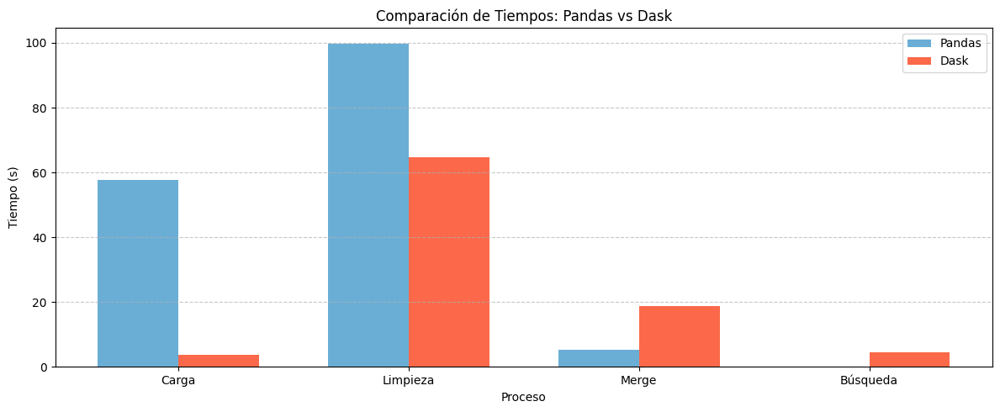

In [ ]:
# Diccionario con los tiempos
data_tiempos = {
    "Proceso": ["Carga", "Limpieza", "Merge", "Búsqueda"],
    "Pandas": [tiempoCargaPandas, tiempoLimpiezaPandas, tiempoMergePandas, tiempoBusquedaPandas],
    "Dask": [tiempoCargaDask, tiempoLimpiezaDask, tiempoMergeDask, tiempoBusquedaDask]
}

df_tiempos = pd.DataFrame(data_tiempos)

# Gráfico Pandas vs Dask
fig, ax = plt.subplots(figsize=(12, 5))
bar_width = 0.35

indices = np.arange(len(df_tiempos))

barras_pandas = ax.bar(indices - bar_width/2, df_tiempos['Pandas'], bar_width, label='Pandas', color=colors_blue[1])
barras_dask = ax.bar(indices + bar_width/2, df_tiempos['Dask'], bar_width, label='Dask', color=colors_red[1])

ax.set_xlabel('Proceso')
ax.set_ylabel('Tiempo (s)')
ax.set_title('Comparación de Tiempos: Pandas vs Dask')
ax.set_xticks(indices)
ax.set_xticklabels(df_tiempos['Proceso'])
ax.legend()

plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

---
# - 2. Visualización de Datos

In [ ]:
dataset = pd.read_csv('TerremotosGlobal_combinados_clean.csv')

# Convertir 'date' y 'time' a una sola columna 'datetime'
dataset['datetime'] = pd.to_datetime(dataset['date'] + ' ' + dataset['time'], format='ISO8601')
dataset.drop(columns=['date', 'time'], inplace=True)

## -- 2.1. Información Básica del Dataset

In [ ]:
print( BOLD_ON + "Nº Instancias del Dataset: " + BOLD_OFF + str(len(dataset)))
print("\n" + BOLD_ON + "Nº Atributos del Dataset: " + BOLD_OFF + str(len(dataset.columns)))

# Atributos numéricos
numeric_cols = dataset.select_dtypes(include=['float64', 'int64'])
stats_numeric_cols = pd.DataFrame({
    'Dtype': numeric_cols.dtypes.values,
    'Non-null Count': numeric_cols.count(),
    'Null Count': numeric_cols.isnull().sum(),

    'Mean': numeric_cols.mean(),        # Media
    'Std': numeric_cols.std(),          # Desviación estándar
    'Min': numeric_cols.min(),          # Mínimo
    '25%': numeric_cols.quantile(0.25), # Percentil 25
    '50%': numeric_cols.quantile(0.50), # Percentil 50 (Mediana)
    '75%': numeric_cols.quantile(0.75), # Percentil 75
    'Max': numeric_cols.max()           # Máximo
})
print("\n" + BOLD_ON + "Información de los Atributos Numéricos del Dataset:" + BOLD_OFF)
display(stats_numeric_cols)

# Atributos categóricos
categorical_cols = dataset.select_dtypes(include=['object'])
stats_categorical_cols = pd.DataFrame({
    'Dtype': categorical_cols.dtypes.values,
    'Non-null Count': categorical_cols.count(),
    'Null Count': categorical_cols.isnull().sum(),

    'Unique': [categorical_cols[col].nunique() for col in categorical_cols.columns],            # Nº Valores Únicos
    'Top': [categorical_cols[col].mode()[0] for col in categorical_cols.columns],               # Valor más frecuente
    'Freq': [categorical_cols[col].value_counts().iloc[0] for col in categorical_cols.columns]  # Frecuencia del valor más frecuente
})
print("\n" + BOLD_ON + "Información de los Atributos Categóricos del Dataset:" + BOLD_OFF)
display(stats_categorical_cols)

# Otro tipo de Atributos
date_time_columns = dataset.select_dtypes(include=['datetime64[ns]'])
stats_date_time_columns = pd.DataFrame({
    'Dtype': date_time_columns.dtypes.values,
    'Non-null Count': date_time_columns.count(),
    'Null Count': date_time_columns.isnull().sum(),

    'Min': date_time_columns.min().values,
    'Max': date_time_columns.max().values,
    'Range': date_time_columns.max() - date_time_columns.min()
})

print("\n" + BOLD_ON + "Información de Atributos de Otro Tipo del Dataset:" + BOLD_OFF)
display(stats_date_time_columns)

Nº Instancias del Dataset: 5317692

Nº Atributos del Dataset: 22

Información de los Atributos Numéricos del Dataset:


,Dtype,Non-null Count,Null Count,Mean,Std,Min,25%,50%,75%,Max
latitude,float64,5317692,0,36.349985,17.910503,-84.4220,33.897333,37.5730,40.729,87.386
longitude,float64,5317692,0,-105.241093,69.161942,-179.9997,-122.855499,-119.0065,-116.352,180.000
mag,float64,5317692,0,1.748988,1.204707,0.0100,0.920000,1.4300,2.160,9.500
depth,float64,5317113,579,18.756234,49.097117,-4.0000,2.726000,6.5500,12.988,735.800
significance,float64,3317104,2000588,76.486689,102.404259,0.0000,15.000000,35.0000,81.000,2910.000
tsunami,float64,3317104,2000588,0.000457,0.021380,0.0000,0.000000,0.0000,0.000,1.000
rms,float64,268379,5049313,0.888305,0.360738,-1.0000,0.710000,0.9000,1.100,69.320
magNst,float64,228289,5089403,31.618094,52.026821,0.0000,7.000000,15.0000,34.000,941.000
depthError,float64,179840,5137852,10.249506,911.629961,-1.0000,1.900000,5.1000,8.900,367558.100
gap,float64,174804,5142888,100.109836,53.028985,6.5000,61.000000,92.7000,128.000,360.000



Información de los Atributos Categóricos del Dataset:


,Dtype,Non-null Count,Null Count,Unique,Top,Freq
status,object,3419397,1898295,3,reviewed,3212248
type,object,3417731,1899961,20,earthquake,3335544
place,object,3417308,1900384,546180,"6 km W of Cobb, California",24136
locationSource,object,316656,5001036,118,us,277026
magSource,object,316656,5001036,160,us,251244
net,object,316656,5001036,24,us,283108
magType,object,316655,5001037,26,mb,227194



Información de Atributos de Otro Tipo del Dataset:


,Dtype,Non-null Count,Null Count,Min,Max,Range
datetime,datetime64[ns],5317692,0,1906-01-02 04:26:27.250,2023-12-29 23:17:18.800,43095 days 18:50:51.550000


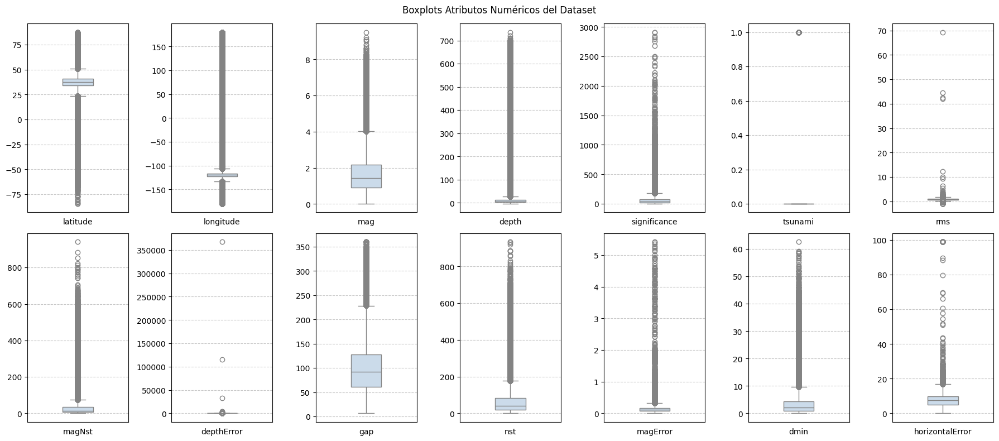

In [ ]:
numeric_columns = dataset.select_dtypes(include=[np.number]).columns

num_types = len(numeric_columns)
half_num_types = math.ceil(num_types / 2)
fig, axes = plt.subplots(2, half_num_types, figsize=(18, 8))
axes = axes.flatten()

for i, attribute in enumerate(numeric_columns):
    sns.boxplot(y=attribute, data=dataset, color=colors_blue[0], ax=axes[i], width=0.3)
    axes[i].set_xlabel("", fontsize=7)
    axes[i].set_ylabel("", fontsize=7)
    axes[i].set_xticks([])
    axes[i].grid(axis='y', linestyle='--', alpha=0.7)

    axes[i].text(0.5, -0.03, attribute, ha='center', va='top', transform=axes[i].transAxes, wrap=True)

if num_types % 2 != 0:
    for j in range(num_types, 2 * half_num_types):
        fig.delaxes(axes[j])

plt.suptitle("Boxplots Atributos Numéricos del Dataset")
plt.tight_layout()
plt.show()

---
## -- 2.2. Visualización por Gráficas

### --- 2.2.1. Análisis General

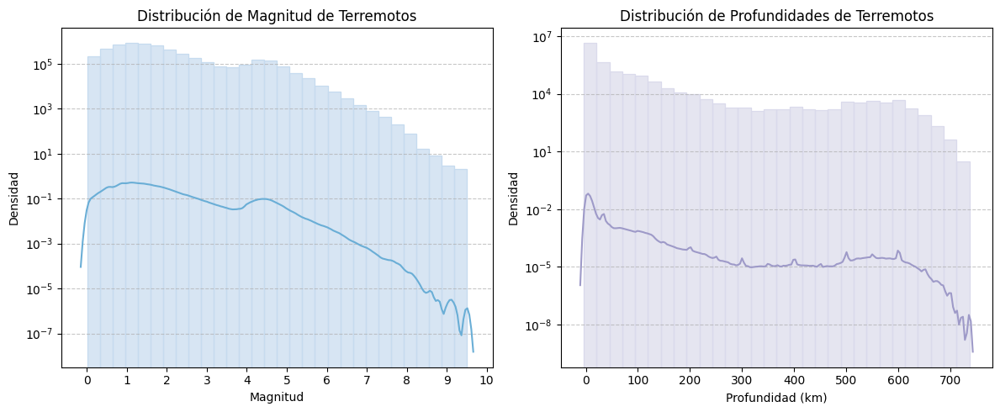

In [ ]:
plt.figure(figsize=(12, 5))

# Gráfica distribución de magnitudes
plt.subplot(1, 2, 1)
sns.histplot(dataset['mag'].dropna(), bins=30, color=colors_blue[0], alpha=0.7, edgecolor=colors_blue[0])
sns.kdeplot(dataset['mag'].dropna(), color=colors_blue[1])
plt.title('Distribución de Magnitud de Terremotos')
plt.xlabel('Magnitud')
plt.ylabel('Densidad')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.yscale("log")
plt.xticks(ticks=np.linspace(0, 10, num=11).astype(int), labels=np.linspace(0, 10, num=11).astype(int))

# Gráfica distribución de profundidades
plt.subplot(1, 2, 2)
sns.histplot(dataset['depth'].dropna(), bins=30, color=colors_purple[0], alpha=0.7, edgecolor=colors_purple[0])
sns.kdeplot(dataset['depth'].dropna(), color=colors_purple[1])
plt.title('Distribución de Profundidades de Terremotos')
plt.xlabel('Profundidad (km)')
plt.ylabel('Densidad')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.yscale("log")
plt.tight_layout()
plt.show()

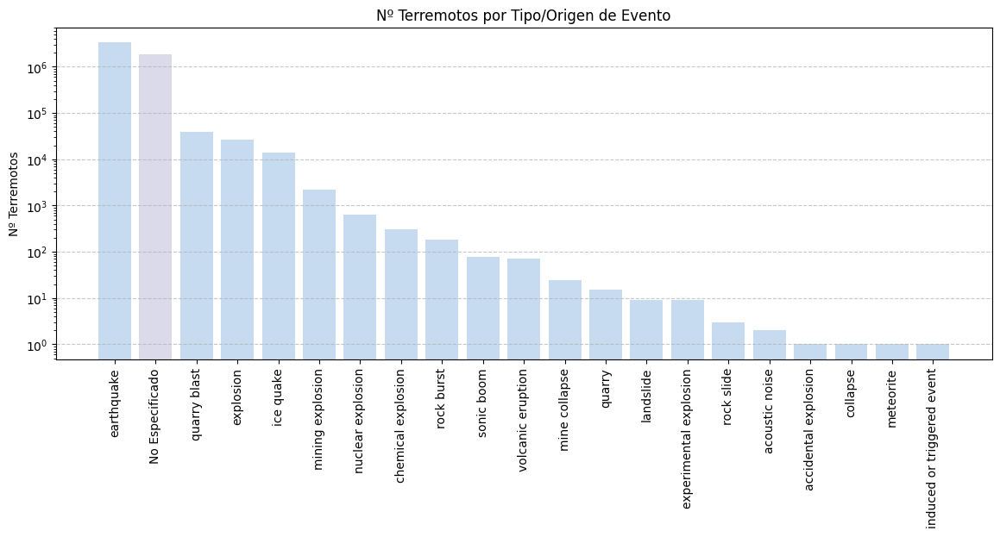

In [ ]:
dataset['type'] = dataset['type'].fillna('No Especificado')

type_order = dataset['type'].value_counts(ascending=False).index

event_type_counts = dataset['type'].value_counts()
event_type_counts = event_type_counts.reindex(type_order)

colors = [colors_blue[0] if t != 'No Especificado' else colors_purple[0] for t in type_order]

# Gráfica Nº Terremotos por Tipo de Evento
plt.figure(figsize=(14, 5))

plt.bar(event_type_counts.index, event_type_counts.values, color=colors, alpha=1)
plt.title('Nº Terremotos por Tipo/Origen de Evento')
plt.ylabel('Nº Terremotos')
plt.xticks(rotation=90)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.yscale('log')

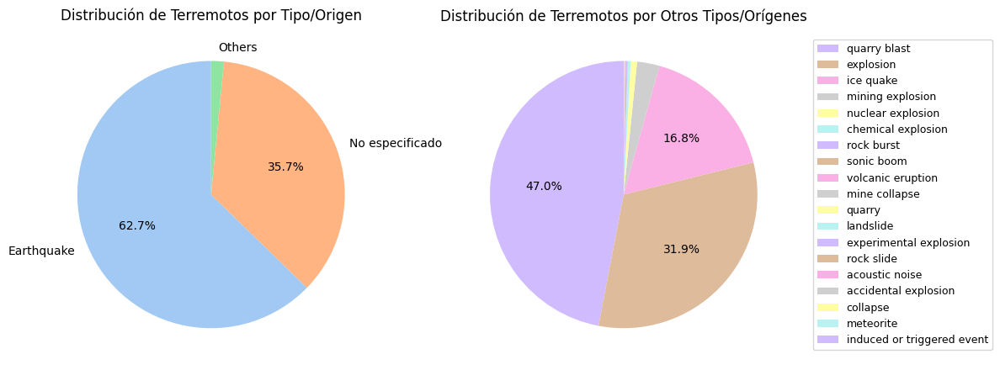

In [ ]:
earthquake_counts = dataset['type'].value_counts().reset_index()
earthquake_counts.columns = ['Type', 'Count']

# Separar los recuentos de "earthquake", "No especificado" y "Otros"
earthquake_count = earthquake_counts[earthquake_counts['Type'] == 'earthquake']['Count'].sum()
no_specified_count = earthquake_counts[earthquake_counts['Type'] == 'No Especificado']['Count'].sum()

other_types = earthquake_counts[(earthquake_counts['Type'] != 'earthquake') &
                                (earthquake_counts['Type'] != 'No Especificado')]
other_count = other_types['Count'].sum()

# Crear el DataFrame general
general_data = pd.DataFrame({
    'Type': ['Earthquake', 'No especificado', 'Others'],
    'Count': [earthquake_count, no_specified_count, other_count]
})

# Función para mostrar porcentajes solo si son mayores que un umbral
def autopct_format(p):
    return '{:.1f}%'.format(p) if p > 5 else ''

colors_sns = sns.color_palette("pastel")

# Gráfico de tarta de terremotos por tipo ("earthquake", "No especificado" y "Otros")
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.pie(general_data['Count'], labels=general_data['Type'], autopct=autopct_format, startangle=90, colors=colors_sns[:3])
plt.title('Distribución de Terremotos por Tipo/Origen')

# Gráfico de tarta de otros tipos de terremotos (Detalle)
plt.subplot(1, 2, 2)
plt.pie(other_types['Count'], startangle=90, autopct=autopct_format, colors=colors_sns[4:])
plt.title('Distribución de Terremotos por Otros Tipos/Orígenes')
plt.legend(other_types['Type'], loc="center left", bbox_to_anchor=(1.05, 0.5), fontsize=9)
plt.subplots_adjust(wspace=0.5)

plt.tight_layout()
plt.show()

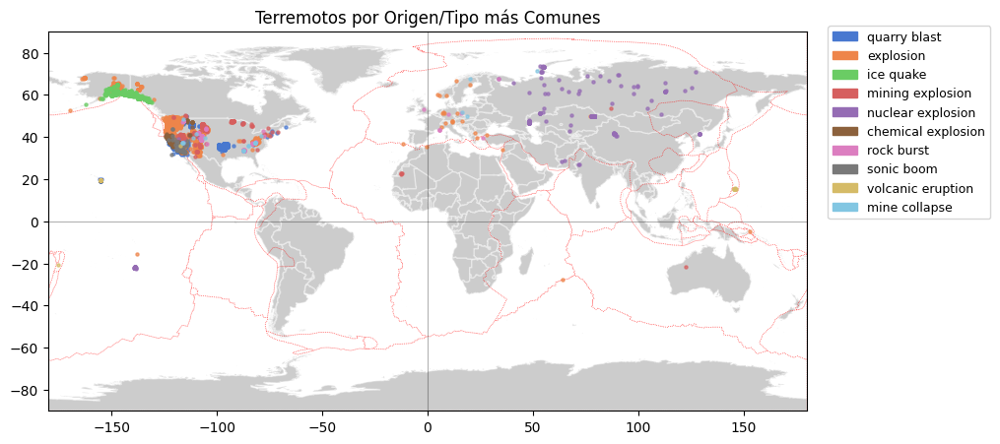

In [ ]:
terremotos_filtrados = dataset[~dataset['type'].isin(['earthquake', 'No Especificado'])]
top_10_types = terremotos_filtrados['type'].value_counts().nlargest(10).index
terremotos_top_10 = terremotos_filtrados[terremotos_filtrados['type'].isin(top_10_types)]

geometry = [Point(xy) for xy in zip(terremotos_top_10['longitude'], terremotos_top_10['latitude'])]
geo_df = gpd.GeoDataFrame(terremotos_top_10, geometry=geometry)

colors = sns.color_palette("muted")
fig, ax = plt.subplots(figsize=(14, 5))

ax.set_xlim([-180, 180])
ax.set_ylim([-90, 90])

map.plot(ax=ax, alpha=0.4, color="grey", edgecolor="white")
placas_tectonicas.plot(ax=ax, color="none", edgecolor="red", alpha=0.5, linewidth=0.5, linestyle=':')

legend_patches = []
for tipo, color in zip(top_10_types, colors):
    subset = geo_df[geo_df['type'] == tipo]
    subset.plot(ax=ax, facecolor=color, markersize=5, alpha=0.7)
    legend_patches.append(mpatches.Patch(color=color, label=tipo))

ax.axhline(0, color='black', linewidth=0.8, alpha=0.3)
ax.axvline(0, color='black', linewidth=0.8, alpha=0.3)

plt.title("Terremotos por Origen/Tipo más Comunes")
plt.legend(handles=legend_patches, loc='lower right', bbox_to_anchor=(1.25, 0.49), fontsize=9)
plt.show()

### --- 2.2.2. Análisis por Fecha

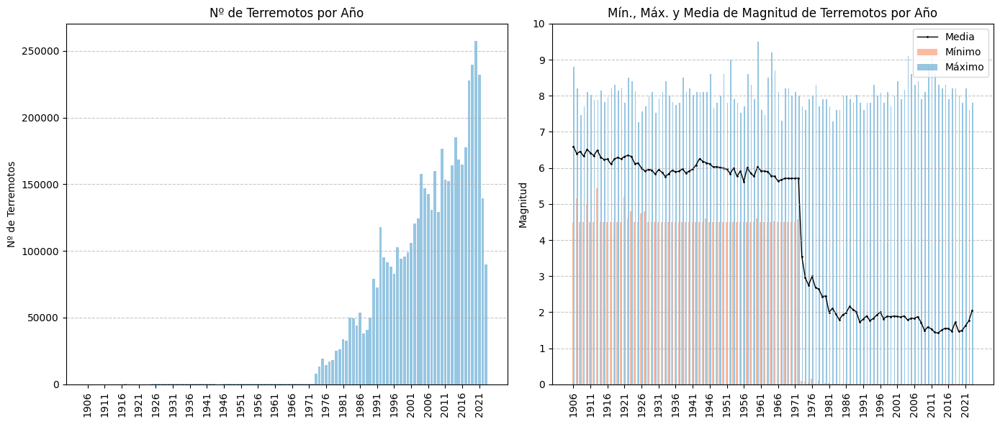

In [ ]:
dataset['year'] = dataset['datetime'].dt.year

min_max_magnitud = (dataset.groupby('year')['mag']
                    .agg(['min', 'max', 'mean'])
                    .rename(columns={'mean': 'media'})
                    .reset_index()
                    .sort_values(by='year'))

earthquake_counts = (dataset.groupby('year')
                     .size()
                     .reset_index(name='count')
                     .sort_values(by='year'))

plt.figure(figsize=(14, 6))

# Gráfico de número de terremotos por año
plt.subplot(1, 2, 1)
plt.bar(earthquake_counts['year'], earthquake_counts['count'],
        color=colors_blue[1], alpha=0.7)
plt.title('Nº de Terremotos por Año')
plt.ylabel('Nº de Terremotos')
plt.xticks(earthquake_counts['year'][::5], rotation=90)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Gráfico de Mínimo, Máximo y Media de magnitud por año
plt.subplot(1, 2, 2)
bar_width = 0.35
indices = np.arange(len(min_max_magnitud['year']))

plt.bar(indices - bar_width/2, min_max_magnitud['min'], width=bar_width, color=colors_red[0], label='Mínimo')
plt.bar(indices + bar_width/2, min_max_magnitud['max'], width=bar_width, color=colors_blue[1], label='Máximo', alpha=0.7)
plt.plot(indices, min_max_magnitud['media'], marker='o', linewidth =1, markersize=1, color="black", label='Media', zorder=1)

plt.title('Mín., Máx. y Media de Magnitud de Terremotos por Año')
plt.ylabel('Magnitud')
plt.xticks(indices[::5], min_max_magnitud['year'][::5], rotation=90)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(loc='upper right')
plt.yticks(ticks=np.linspace(0, 10, num=11).astype(int))

plt.tight_layout()
plt.show()

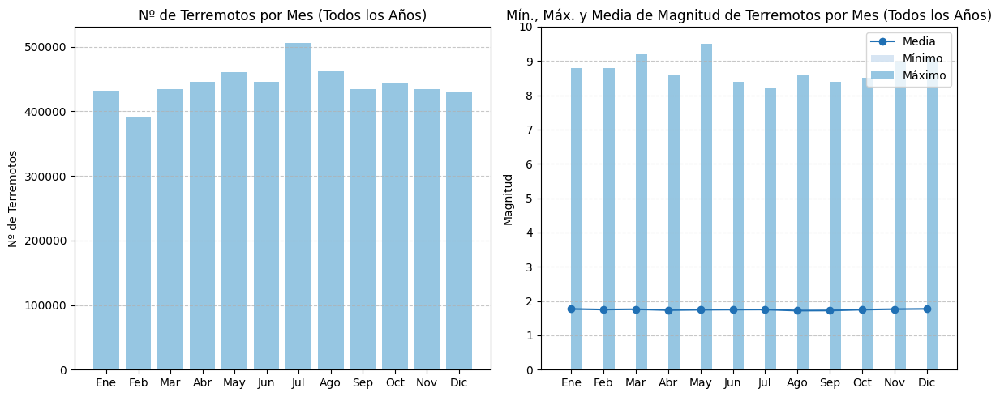

In [ ]:
meses = ['Ene', 'Feb', 'Mar', 'Abr', 'May', 'Jun',
                    'Jul', 'Ago', 'Sep', 'Oct', 'Nov', 'Dic']
dataset['month'] = dataset['datetime'].dt.month

# Min, max y media de magnitud por mes
min_max_magnitud = (dataset.groupby('month')['mag']
                    .agg(['min', 'max', 'mean'])
                    .rename(columns={'mean': 'media'})
                    .reset_index()
                    .sort_values(by='month'))

# Número de terremotos por mes
earthquake_counts = (dataset.groupby('month')
                     .size()
                     .reset_index(name='count')
                     .sort_values(by='month'))

plt.figure(figsize=(12, 5))
# Gráfico de número de terremotos por mes
plt.subplot(1, 2, 1)
plt.bar(earthquake_counts['month'], earthquake_counts['count'], color=colors_blue[1], alpha=0.7)
plt.title('Nº de Terremotos por Mes (Todos los Años)')
plt.ylabel('Nº de Terremotos')
plt.xticks(earthquake_counts['month'], meses)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Gráfico de Mínimo, Máximo y Media de magnitud por mes
plt.subplot(1, 2, 2)
bar_width = 0.35
indices = np.arange(len(min_max_magnitud['month']))

plt.bar(indices - bar_width/2, min_max_magnitud['min'], width=bar_width, color=colors_blue[0], label='Mínimo', alpha=0.7)
plt.bar(indices + bar_width/2, min_max_magnitud['max'], width=bar_width, color=colors_blue[1], label='Máximo', alpha=0.7)
plt.plot(indices, min_max_magnitud['media'], marker='o', color=colors_blue[2], label='Media', zorder=5)

plt.title('Mín., Máx. y Media de Magnitud de Terremotos por Mes (Todos los Años)')
plt.ylabel('Magnitud')
plt.xticks(indices, meses)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(loc='upper right')
plt.yticks(ticks=np.linspace(0, 10, num=11).astype(int))

plt.tight_layout()
plt.show()

### --- 2.2.3. Análisis por Magnitud

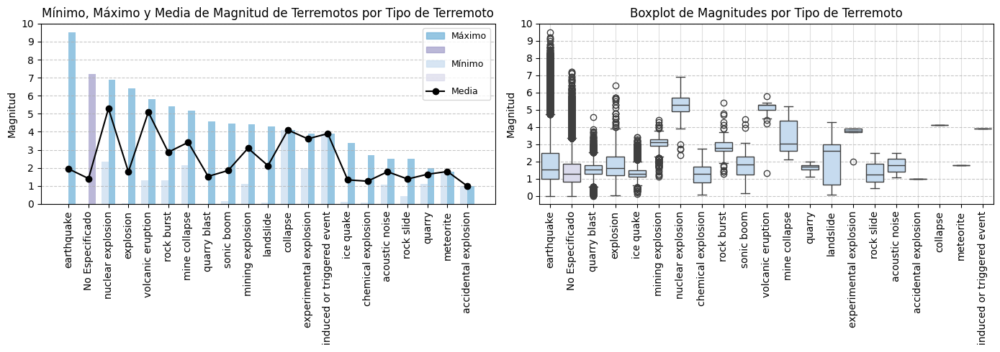

In [ ]:
colors = [colors_blue[0] if t != 'No Especificado' else colors_purple[0]
          for t in dataset['type'].unique()]

type_order = dataset['type'].value_counts(ascending=False).index

event_type_counts = dataset['type'].value_counts()
event_type_counts = event_type_counts.reindex(type_order)

min_max_magnitud = dataset.groupby('type')['mag'].agg(['min', 'max']).reset_index()

mean_magnitude = dataset.groupby('type')['mag'].mean().reset_index()
mean_magnitude.rename(columns={'mag': 'media'}, inplace=True)

min_max_magnitud = min_max_magnitud.merge(mean_magnitude, on='type')
min_max_magnitud.sort_values(by='max', ascending=False, inplace=True)

# Gráfico de barras para el mínimo y máximo
plt.figure(figsize=(14, 5))
plt.subplot(1, 2, 1)
bar_width = 0.35
indices = np.arange(len(min_max_magnitud['type']))

bar_colors_min = [colors_blue[0] if t != 'No Especificado' else colors_purple[0] for t in min_max_magnitud['type']]
bar_colors_max = [colors_blue[1] if t != 'No Especificado' else colors_purple[1] for t in min_max_magnitud['type']]

plt.bar(indices - bar_width/2, min_max_magnitud['min'], width=bar_width, color=bar_colors_min, label='Mínimo', alpha=0.7)
plt.bar(indices + bar_width/2, min_max_magnitud['max'], width=bar_width, color=bar_colors_max, label='Máximo', alpha=0.7)
plt.plot(indices, min_max_magnitud['media'], marker='o', color="black", label='Media', zorder=5)

plt.title('Mínimo, Máximo y Media de Magnitud de Terremotos por Tipo de Terremoto')
plt.xlabel('')
plt.ylabel('Magnitud')
plt.xticks(indices, min_max_magnitud['type'], rotation=90)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(
    handles=[
        plt.Rectangle((0, 0), 1, 1, color=colors_blue[1], alpha=0.7),
        plt.Rectangle((0, 0), 1, 1, color=colors_purple[1], alpha=0.7),
        plt.Rectangle((0, 0), 1, 1, color=colors_blue[0], alpha=0.7),
        plt.Rectangle((0, 0), 1, 1, color=colors_purple[0], alpha=0.7),
        plt.Line2D([0], [0], marker='o', color='black', linestyle='-', label='Media', markerfacecolor='black'),
    ],
    labels=['Máximo', '', 'Mínimo', '', 'Media'],
    fontsize=9
)

plt.yticks(ticks=np.linspace(0, 10 , num=11).astype(int),
           labels= np.linspace(0, 10, num=11).astype(int))

# Boxplot de Magnitudes por Tipo de Terremoto
plt.subplot(1, 2, 2)
boxplot = sns.boxplot(x='type', y='mag', data=dataset, order=type_order)

colors = [colors_blue[0] if t != 'No Especificado' else colors_purple[0]
          for t in type_order]

for i, patch in enumerate(boxplot.patches):
    patch.set_facecolor(colors[i])

plt.title('Boxplot de Magnitudes por Tipo de Terremoto')
plt.ylabel('Magnitud')
plt.xlabel('')
plt.xticks(rotation=90)
plt.yticks(ticks=np.linspace(0, 10, num=11).astype(int),
           labels=np.linspace(0, 10, num=11).astype(int))
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.grid(axis='x', linestyle='-', alpha=0.4)

plt.tight_layout()
plt.show()

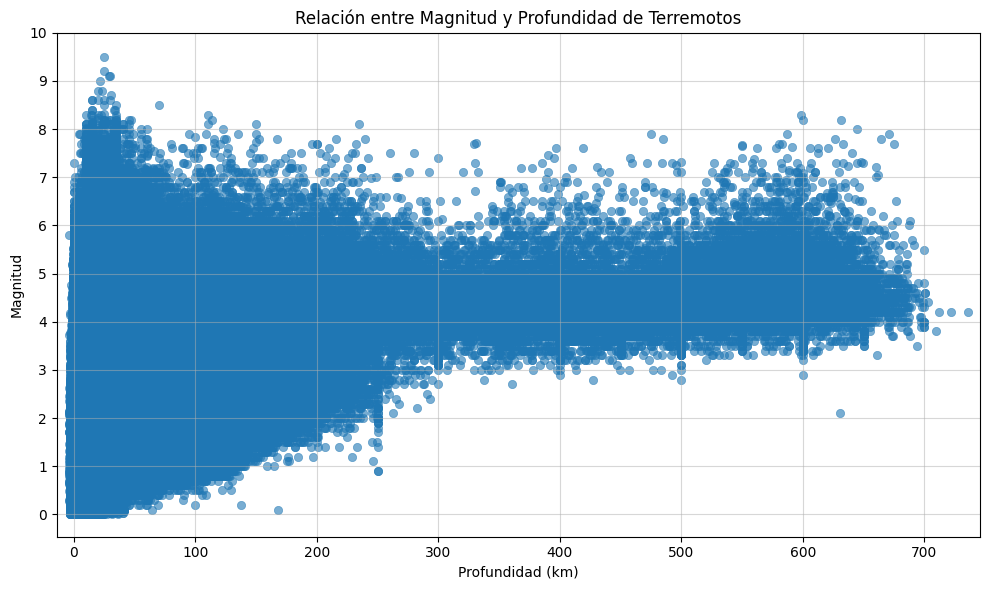

In [ ]:
plt.figure(figsize=(10, 6))

# Diagrama de dispersión de magnitud - profundidad
sns.scatterplot(data=dataset, x='depth', y='mag', alpha=0.6, edgecolor=None)

plt.title('Relación entre Magnitud y Profundidad de Terremotos')
plt.xlabel('Profundidad (km)')
plt.ylabel('Magnitud')
plt.grid(alpha=0.5)
plt.xlim(dataset['depth'].min() - 10, dataset['depth'].max() + 10)
plt.yticks(range(0, 11))
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.grid(axis='x', linestyle='-', alpha=0.4)

plt.tight_layout()
plt.show()

### --- 2.2.4. Análisis por Profundidad

* El análisis de los valores del atributo "depth" por origen/tipo de terremoto ha revelado varios eventos con profundidades negativas, lo cual es inusual. Tras investigar más a fondo, se han identificado algunas explicaciones posibles para estos datos atípicos:
  * **Eventos Superficiales y No Tectónicos**: Algunos tipos de eventos, como los "sonic boom" (provocados por explosiones sónicas cuando un objeto supera la velocidad del sonido, como aviones) o "quarry blast" (debido a actividades en canteras que generan sismos por explosiones controladas), podrían ocurrir en la superficie o por encima del nivel del mar, lo que explicaría la profundidad negativa.
  * **Datos Erróneos o Mal Categorizados**: Los terremotos en si, catalogados como "earthquake", pueden estar sujetos a errores de medición o categorización. Sin embargo, es posible que en regiones montañosas se registren eventos naturales no necesariamente tectónicos, como volcanes o avalanchas.


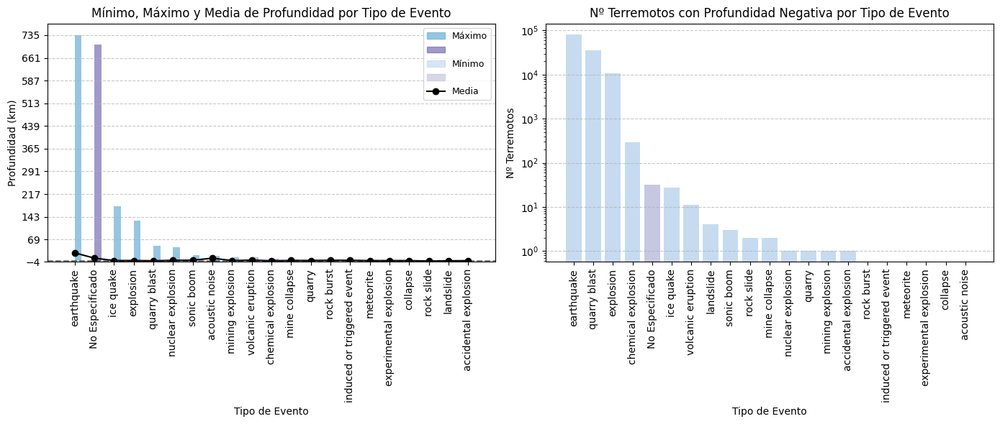

In [ ]:
# Valores de profundidad por tipo de evento
min_max_depth = (
    dataset.groupby('type')['depth']
    .agg(min='min', max='max', media='mean')
    .reset_index()
)

# Terremotos con profundidad negativa
negative_depth_count = (
    dataset[dataset['depth'] < 0]
    .groupby('type')
    .size()
    .reset_index(name='negative_count')
)

min_max_depth = min_max_depth.merge(negative_depth_count, on='type', how='left').fillna(0)
min_max_depth.sort_values(by='max', ascending=False, inplace=True)

colors = [colors_blue[1] if t != 'No Especificado' else colors_purple[1] for t in dataset['type'].unique()]

plt.figure(figsize=(14, 6))
bar_width = 0.35

indices = np.arange(len(min_max_depth['type']))

# Gráfica Mínimo, Máximo y Media de profundidad
plt.subplot(1, 2, 1)
bar_colors_min = [colors_blue[0] if t != 'No Especificado' else colors_purple[0] for t in min_max_depth['type']]
bar_colors_max = [colors_blue[1] if t != 'No Especificado' else colors_purple[1] for t in min_max_depth['type']]

plt.bar(indices - bar_width/2, min_max_depth['min'], width=bar_width, color=bar_colors_min, label='Mínimo', alpha=0.7)
plt.bar(indices + bar_width/2, min_max_depth['max'], width=bar_width, color=bar_colors_max, label='Máximo', alpha=0.7)
plt.plot(indices, min_max_depth['media'], marker='o', color="black", label='Media', zorder=5)


plt.title('Mínimo, Máximo y Media de Profundidad por Tipo de Evento')
plt.xlabel('Tipo de Evento')
plt.ylabel('Profundidad (km)')
plt.xticks(indices, min_max_depth['type'], rotation=90)
plt.axhline(y=0, linestyle='--', color="black", alpha=0.5)
plt.ylim(bottom=min(min_max_depth['min'].min(), 0))
plt.yticks(ticks=np.linspace(min(min_max_depth['min'].min(), 0), min_max_depth['max'].max(), num=11).astype(int))
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(
    handles=[
        plt.Rectangle((0, 0), 1, 1, color=colors_blue[1], alpha=0.7),
        plt.Rectangle((0, 0), 1, 1, color=colors_purple[1], alpha=0.7),
        plt.Rectangle((0, 0), 1, 1, color=colors_blue[0], alpha=0.7),
        plt.Rectangle((0, 0), 1, 1, color=colors_purple[0], alpha=0.7),
        plt.Line2D([0], [0], marker='o', color='black', linestyle='-', label='Media', markerfacecolor='black'),
    ],
    labels=['Máximo', '', 'Mínimo', '', 'Media'],
    fontsize=9
)

# Gráfico de barras para profundidades negativas
plt.subplot(1, 2, 2)
negative_depth_count = negative_depth_count.set_index('type').reindex(min_max_depth['type']).fillna(0)['negative_count']

depth_data = pd.DataFrame({'type': min_max_depth['type'], 'negative_count': negative_depth_count.values})
depth_data.sort_values(by='negative_count', ascending=False, inplace=True)

bar_colors = [colors_blue[0] if t != 'No Especificado' else colors_purple[0] for t in depth_data['type']]

plt.bar(depth_data['type'], depth_data['negative_count'], color=bar_colors, alpha=1)
plt.title('Nº Terremotos con Profundidad Negativa por Tipo de Evento')
plt.xlabel('Tipo de Evento')
plt.ylabel('Nº Terremotos')
plt.xticks(rotation=90)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.yscale('log')
plt.tight_layout()
plt.show()

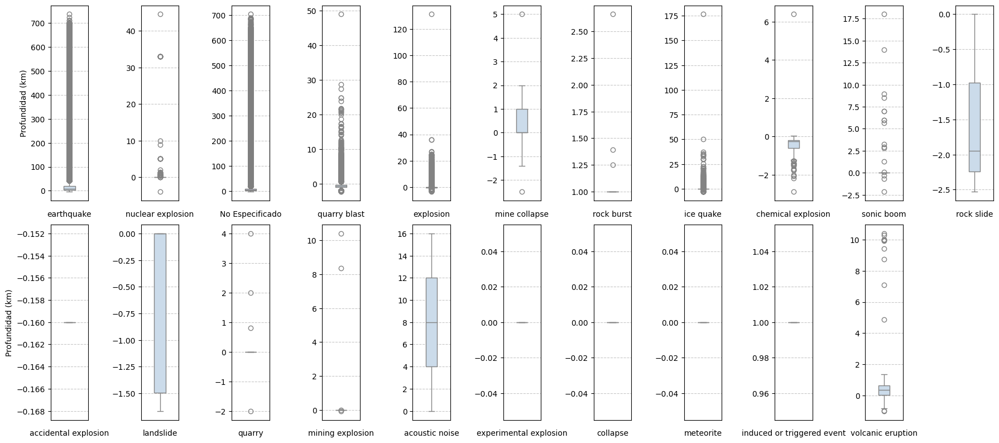

In [ ]:
colors = [colors_blue[0] if t != 'No Especificado' else colors_purple[0] for t in dataset['type'].unique()]

types_unique = dataset['type'].unique()

num_types = len(types_unique)
half_num_types = math.ceil(num_types / 2)
fig, axes = plt.subplots(2, half_num_types, figsize=(18, 8))
axes = axes.flatten()

for i, event_type in enumerate(types_unique):
    sns.boxplot(x='type', y='depth', data=dataset[dataset['type'] == event_type], color=colors[i], ax=axes[i], width=0.3)
    axes[i].set_ylabel('Profundidad (km)' if i % half_num_types == 0 else '')
    axes[i].set_xlabel("", fontsize=7)
    axes[i].set_xticks([])
    axes[i].grid(axis='y', linestyle='--', alpha=0.7)

    axes[i].text(0.5, -0.03, event_type, ha='center', va='top', transform=axes[i].transAxes, wrap=True)

if num_types % 2 != 0:
    for j in range(num_types, 2 * half_num_types):
        fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

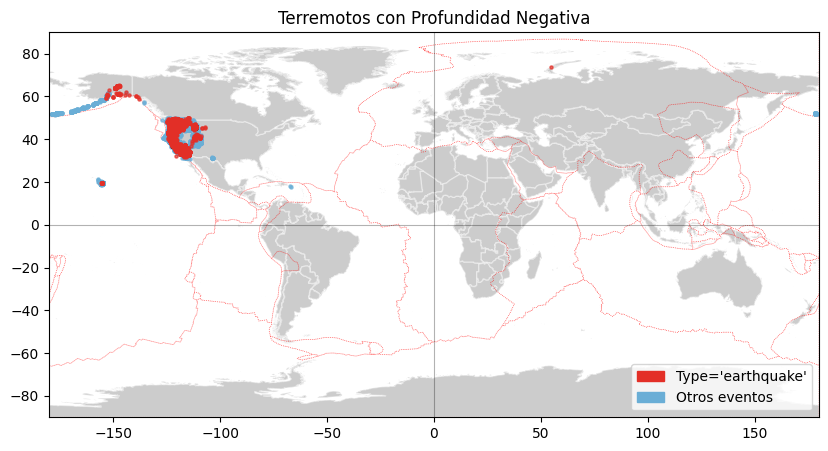

In [ ]:
dataset_negativos_earthquake = dataset[(dataset['depth'] < 0) & (dataset['type'] == 'earthquake')]
dataset_negativos_no_earthquake = dataset[(dataset['depth'] < 0) & (dataset['type'] != 'earthquake')]

geometry_earthquake = [Point(xy) for xy in zip(dataset_negativos_earthquake['longitude'], dataset_negativos_earthquake['latitude'])]
geometry_no_earthquake = [Point(xy) for xy in zip(dataset_negativos_no_earthquake['longitude'], dataset_negativos_no_earthquake['latitude'])]

geo_df_earthquake = gpd.GeoDataFrame(dataset_negativos_earthquake, geometry=geometry_earthquake)
geo_df_no_earthquake = gpd.GeoDataFrame(dataset_negativos_no_earthquake, geometry=geometry_no_earthquake)

geo_df_earthquake = geo_df_earthquake.sort_values(by='depth', ascending=True)
geo_df_no_earthquake = geo_df_no_earthquake.sort_values(by='depth', ascending=True)

fig, ax = plt.subplots(figsize=(14, 5))

ax.set_xlim([-180, 180])
ax.set_ylim([-90, 90])

# Graficar el mapa base y las placas tectónicas
map.plot(ax=ax, alpha=0.4, color="grey", edgecolor="white")
placas_tectonicas.plot(ax=ax, color="none", edgecolor="red", alpha=0.5, linewidth=0.5, linestyle=':')

geo_df_earthquake.plot(ax=ax, alpha=0.7, color=colors_blue[1], markersize=5)
geo_df_no_earthquake.plot(ax=ax, alpha=0.7, color=colors_red[1], markersize=5)

ax.axhline(0, color='black', linewidth=0.8, alpha=0.3)
ax.axvline(0, color='black', linewidth=0.8, alpha=0.3)

plt.title("Terremotos con Profundidad Negativa")
earthquake_patch = mpatches.Patch(color=colors_red[1], label="Type='earthquake'")
no_earthquake_patch = mpatches.Patch(color=colors_blue[1], label='Otros eventos')

plt.legend(handles=[earthquake_patch, no_earthquake_patch], loc='lower right')
plt.show()

### --- 2.2.5. Análisis de Terremotos Tsunamigénicos

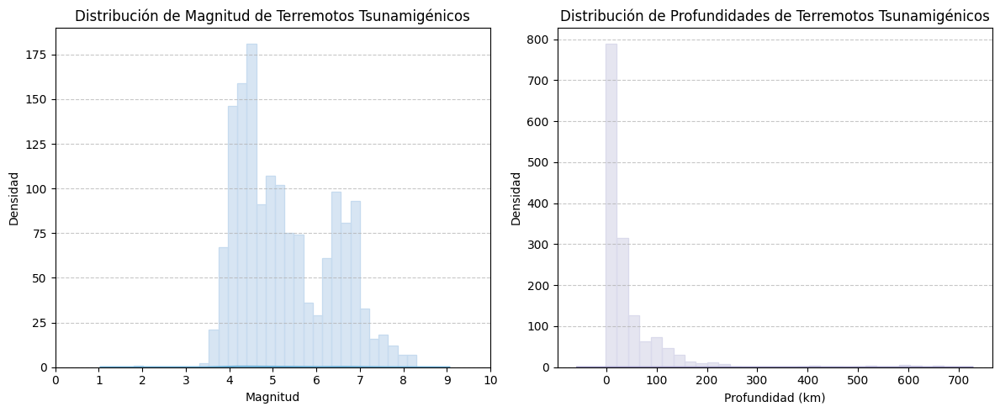

In [ ]:
dataset_tsunami = dataset[dataset['tsunami'] == 1]

plt.figure(figsize=(12, 5))

# Gráfica distribución de magnitudes
plt.subplot(1, 2, 1)
sns.histplot(dataset_tsunami['mag'].dropna(), bins=30, color=colors_blue[0], alpha=0.7, edgecolor=colors_blue[0])
sns.kdeplot(dataset_tsunami['mag'].dropna(), color=colors_blue[1])
plt.title('Distribución de Magnitud de Terremotos Tsunamigénicos')
plt.xlabel('Magnitud')
plt.ylabel('Densidad')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.xticks(ticks=np.linspace(0, 10, num=11).astype(int), labels=np.linspace(0, 10, num=11).astype(int))

# Gráfica distribución de profundidades
plt.subplot(1, 2, 2)
sns.histplot(dataset_tsunami['depth'].dropna(), bins=30, color=colors_purple[0], alpha=0.7, edgecolor=colors_purple[0])
sns.kdeplot(dataset_tsunami['depth'].dropna(), color=colors_purple[1])
plt.title('Distribución de Profundidades de Terremotos Tsunamigénicos')
plt.xlabel('Profundidad (km)')
plt.ylabel('Densidad')
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

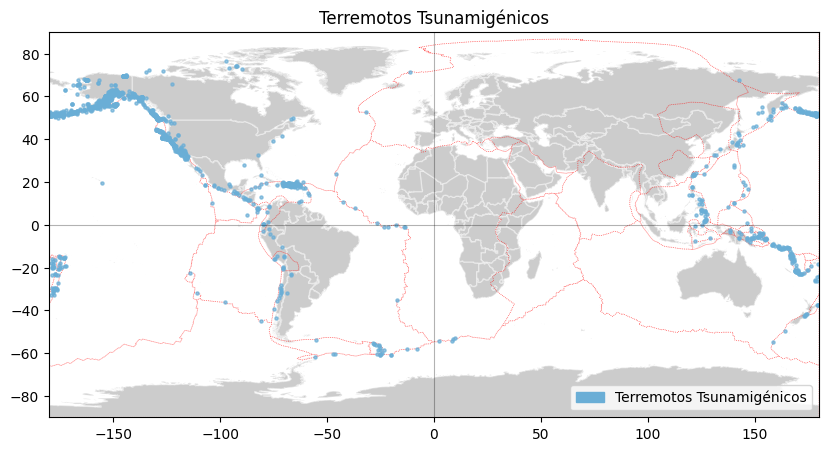

In [ ]:
dataset_tsunami = dataset[dataset['tsunami'] == 1]

geometry_tsunami = [Point(xy) for xy in zip(dataset_tsunami['longitude'], dataset_tsunami['latitude'])]
geo_df_tsunami = gpd.GeoDataFrame(dataset_tsunami, geometry=geometry_tsunami)

fig, ax = plt.subplots(figsize=(14, 5))

ax.set_xlim([-180, 180])
ax.set_ylim([-90, 90])

map.plot(ax=ax, alpha=0.4, color="grey", edgecolor="white")
placas_tectonicas.plot(ax=ax, color="none", edgecolor="red", alpha=0.5, linewidth=0.5, linestyle=':')
geo_df_tsunami.plot(ax=ax, alpha=0.7, color=colors_blue[1], markersize=5)

ax.axhline(0, color='black', linewidth=0.8, alpha=0.3)
ax.axvline(0, color='black', linewidth=0.8, alpha=0.3)

plt.title("Terremotos Tsunamigénicos")
tsunami_patch = mpatches.Patch(color=colors_blue[1], label="Terremotos Tsunamigénicos")
plt.legend(handles=[tsunami_patch], loc='lower right')

plt.show()

---
## -- 2.3. Visualización por Mapas

In [ ]:
dataset = pd.read_csv('TerremotosGlobal_combinados_clean.csv')

dataset['datetime'] = pd.to_datetime(dataset['date'] + ' ' + dataset['time'], format='ISO8601')
dataset.drop(columns=['date', 'time'], inplace=True)

dataset['type'] = dataset['type'].fillna('No Especificado')

### --- 2.3.1. Mapas - Todos los Años

In [ ]:
anios = dataset['datetime'].dt.year.unique().tolist()

#### ---- 2.3.1.1. Mapa Global

In [ ]:
rutas = generar_graficos_para_anios(anios, None)

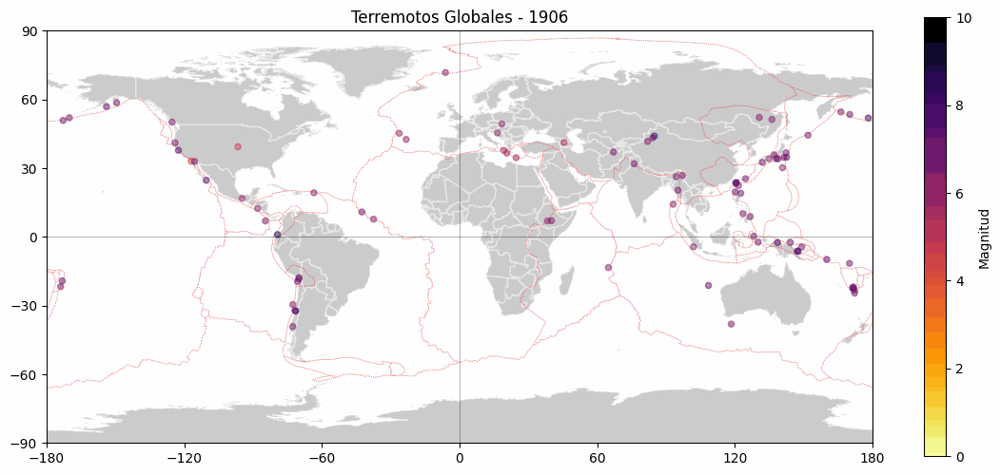

In [ ]:
Image(open(crear_gif(rutas, None),'rb').read())

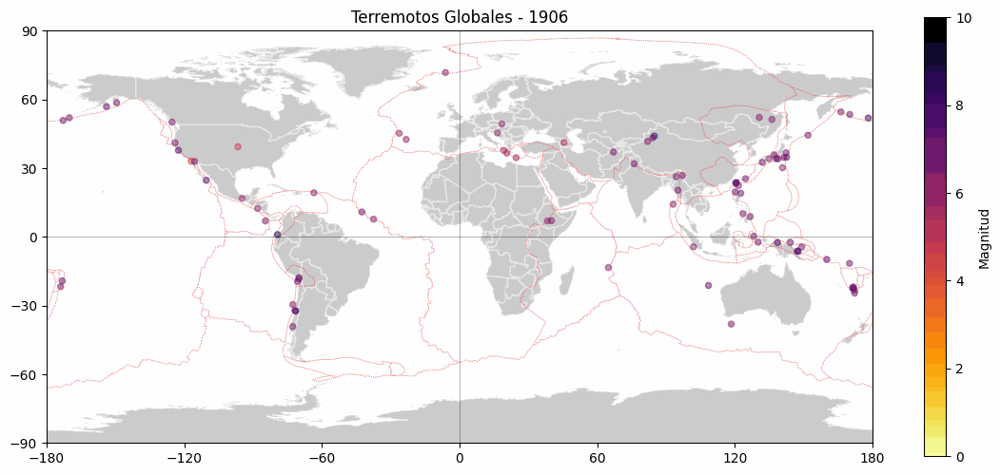

In [ ]:
Image(open(crear_gif(rutas, None, duration=500),'rb').read())

#### ---- 2.3.1.2. Mapa España

In [ ]:
rutas_spain = generar_graficos_para_anios(anios, "Spain")

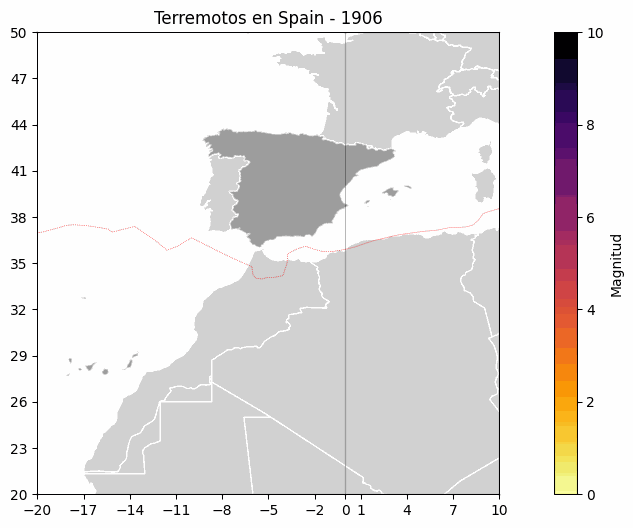

In [ ]:
Image(open(crear_gif(rutas_spain, None, duration=500),'rb').read())

#### ---- 2.3.1.3. Mapa Japón

In [ ]:
rutas_japan = generar_graficos_para_anios(anios, "Japan")

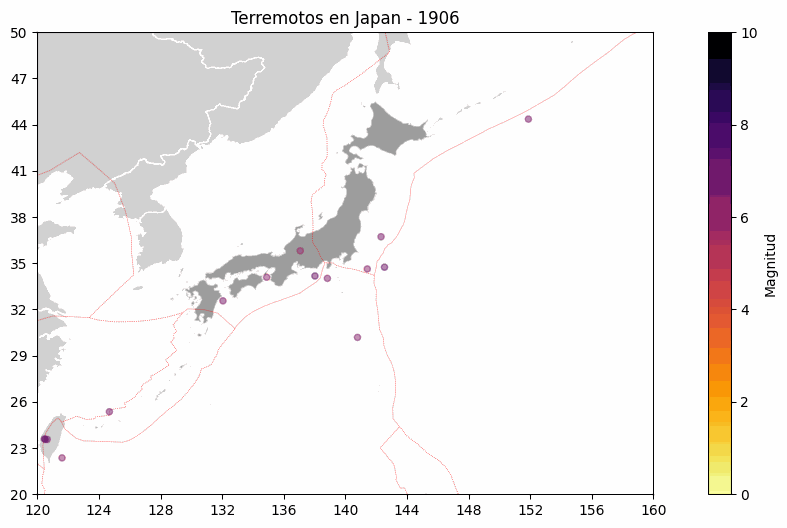

In [ ]:
Image(open(crear_gif(rutas_japan, None, duration=500),'rb').read())

---
### --- 2.3.2. Mapas - En Detalle

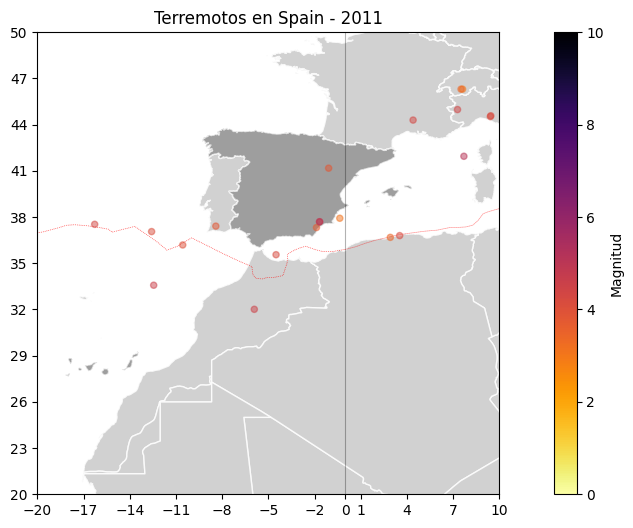

In [ ]:
Image(open(generar_graficos_para_anios([2011], "Spain")[0],'rb').read())

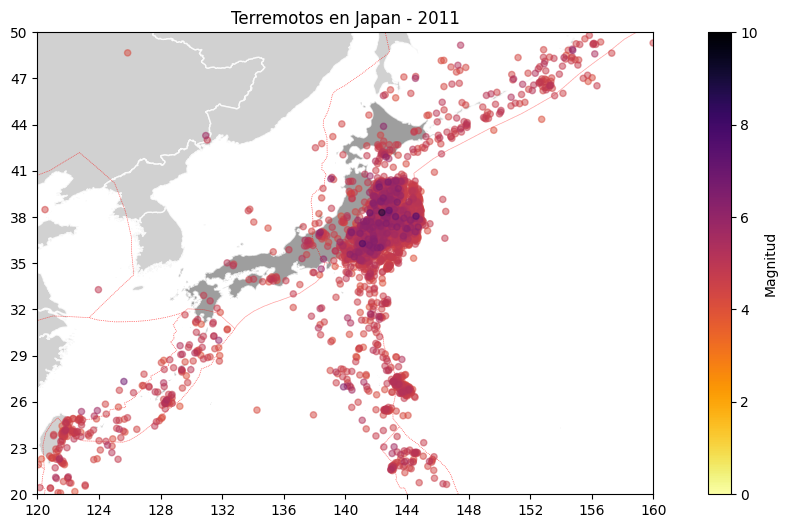

In [ ]:
Image(open(generar_graficos_para_anios([2011], "Japan")[0],'rb').read())

---
### --- 2.3.3. Mapa Interactivo
* [[Video Mapa Interactivo]](https://youtu.be/p4V7WkXOnS0?si=asoJpzEDgU_4-D2D)

In [ ]:
df = dataset.sample(n=int(len(dataset) / 5000), random_state=1)
print(BOLD_ON + "Tamaño del dataset utilizado por el mapa interactivo: " + BOLD_OFF, len(df))

Tamaño del dataset utilizado por el mapa interactivo:  1063


In [ ]:
country_options = ["Global"] + list(map['ADMIN'].unique())
combobox_country = Combobox(
    options=country_options,
    value="Global",
    description='Ubicación:',
    layout=Layout(width='400px')
)

years = sorted(dataset['datetime'].dt.year.unique())
years_options = ["Todos los años"] + list(years)

dropdown_year = Dropdown(
    options=years_options,
    value="Todos los años",
    description='Año:',
    layout=Layout(width='400px')
)

m = Map(center=(0, 0), zoom=1.2, layout=Layout(height='700px', width='1100px', color="white", background_color='white'),
         basemap=basemaps.CartoDB.Positron, scroll_wheel_zoom=True)

m.layers = [TileLayer(url='https://{s}.basemaps.cartocdn.com/light_all/{z}/{x}/{y}.png', opacity=0, no_wrap=False)]

def on_zoom_change(change):
    if m.zoom < m.min_zoom:
        m.zoom = m.min_zoom
    elif m.zoom > m.max_zoom:
        m.zoom = m.max_zoom

m.observe(on_zoom_change, names='zoom')

m.max_bounds = [[-90, -180], [90, 180]]
m.max_bounds_visible = True

m.min_zoom = 2
m.max_zoom = 18

output = Output()

layer_group = None

def get_color(magnitude):
    cmap = plt.get_cmap('inferno_r')
    normalized_mag = np.clip(magnitude / 10, 0, 1)
    rgba = cmap(normalized_mag)
    color_hex = to_hex(rgba)
    return color_hex

def update_markers(selected_country, selected_year):
    global layer_group

    if layer_group:
        m.remove_layer(layer_group)

    if selected_country == "Global":
        country_earthquakes = df.copy()
    else:
        country_geom = map[map['ADMIN'] == selected_country]
        bounds = country_geom.total_bounds
        minx, miny, maxx, maxy = bounds

        country_earthquakes = df.query(
            '@minx <= longitude <= @maxx and @miny <= latitude <= @maxy'
        )

    if selected_year != "Todos los años":
        country_earthquakes = country_earthquakes.query('datetime.dt.year == @selected_year')

    markers = []

    for idx, row in country_earthquakes.iterrows():
        circle_size = 5
        marker_color = get_color(row['mag'])

        marker = CircleMarker(location=(row['latitude'], row['longitude']),
                              radius=round(circle_size),
                              color=marker_color,
                              fill_opacity=0.5,
                              draggable=False)

        marker.popup = HTML(f"""
            <div style="font-family: Arial, sans-serif; padding: 10px;">
                <h4 style="margin: 0; color: #333;">Información del Terremoto</h4>
                <div style="width: 100%; height: 1px; background-color: #333;"></div>
                <p style="margin: 1px 0;"><strong>Fecha:</strong> {row['datetime'].strftime('%Y-%m-%d %H:%M:%S')}</p>
                <p style="margin: 1px 0;"><strong>Coordenadas:</strong> ({row['latitude']}, {row['longitude']})</p>
                <p style="margin: 1px 0;"><strong>Magnitud:</strong> {row['mag']}</p>
                <p style="margin: 1px 0;"><strong>Tipo/Origen:</strong> {row['type']}</p>
            </div>
        """)

        markers.append(marker)

    layer_group = LayerGroup(layers=markers)
    m.add_layer(layer_group)

update_markers(combobox_country.value, dropdown_year.value)

map_geojson = json.loads(map.to_json())
geo_layer = GeoJSON(
    data=map_geojson,
    style={
        'color': 'white',
        'fillColor': 'grey',
        'fillOpacity': 0.5,
        'weight': 1
    }
)
m.add_layer(geo_layer)

placas_geojson = json.loads(placas_tectonicas.to_json())
placas_layer = GeoJSON(
    data=placas_geojson,
    style={
        'color': 'red',
        'weight': 0.5,
        'opacity': 0.8,
        'fillOpacity': 0,
        'dashArray': '5, 5'
    }
)
m.add_layer(placas_layer)

m.add_layer(Polyline(locations=[[-90, 0], [90, 0]], color='black', weight=1, opacity=0.3))
m.add_layer(Polyline(locations=[[0, -180], [0, 180]], color='black', weight=1, opacity=0.3))

def on_combobox_country_change(change):
    update_markers(change['new'], dropdown_year.value)

def on_dropdown_year_change(change):
    update_markers(combobox_country.value, change['new'])

combobox_country.observe(on_combobox_country_change, names='value')
dropdown_year.observe(on_dropdown_year_change, names='value')

def restrict_bounds(change):
    bounds = m.bounds
    margen_permitido = 60

    adjusted_bounds = [[m.max_bounds[0][0] - margen_permitido, m.max_bounds[0][1] - margen_permitido],
                       [m.max_bounds[1][0] + margen_permitido, m.max_bounds[1][1] + margen_permitido]]

    if (bounds[0][0] < adjusted_bounds[0][0] or bounds[0][1] < adjusted_bounds[0][1] or
        bounds[1][0] > adjusted_bounds[1][0] or bounds[1][1] > adjusted_bounds[1][1]):

        if (bounds[0][0] < m.max_bounds[0][0] or bounds[0][1] < m.max_bounds[0][1] or
            bounds[1][0] > m.max_bounds[1][0] or bounds[1][1] > m.max_bounds[1][1]):

            m.center = ((m.max_bounds[0][0] + m.max_bounds[1][0]) / 2,
                         (m.max_bounds[0][1] + m.max_bounds[1][1]) / 2)

m.observe(restrict_bounds, names='bounds')

html_style = """
<style>
    .leaflet-container {
        background-color: white !important;
        margin: 0 !important;
    }
    .jupyter-widgets.leaflet-widgets{
        border: 1px solid black !important;
    }
</style>
"""

display(VBox([HTML(html_style), VBox([combobox_country, dropdown_year, m, output])]))

---
# 3. Modelo de IA

In [ ]:
dataset = pd.read_csv('TerremotosGlobal_combinados_clean.csv')

# Convertir 'date' y 'time' a una sola columna 'datetime'
dataset['datetime'] = pd.to_datetime(dataset['date'] + ' ' + dataset['time'], format='ISO8601')
dataset.drop(columns=['date', 'time'], inplace=True)

# Ordenar el dataset por el atributo "datetime"
dataset = dataset.sort_values(by='datetime')

## -- 3.1. Preprocesado de Datos
* **Variable Objetivo ("tsunami") y Balanceo de Clases**:
  * El dataset completo consta de únicamente 1517 terremotos tsunamigénicos, que son el objetivo del modelo de clasificación a desarrollar. Para abordar el problema del desbalanceo de clases, se implementará un proceso de balanceo, esencial para evitar el sobreentrenamiento y los falsos negativos.
  En total, se contará con 1517 instancias relevantes (terremotos tsunamigénicos) y 4551 instancias no relevantes (tres veces más datos).
* **Tratamiento de Nulos**:
  * Los atributos "datetime", "latitude", "longitude" y "mag" están presentes en todas las instancias del dataset, lo que garantiza que estas variables están completas y son confiables para el entrenamiento.
  * El atributo "depth" presenta valores faltantes en 579 instancias. Sin embargo, dado que estas instancias tienen un valor de tsunami igual a 0, son irrelevantes para el entrenamiento.

In [ ]:
# Tratamiento de nulos (eliminación de valores nulos en el atributo "depth")
dataset = dataset.dropna(subset=['depth'])

In [ ]:
# Balanceo de clases
filas_relevantes = dataset[dataset['tsunami'] == 1]
filas_no_relevantes = dataset[dataset['tsunami'] == 0]

# Creación de un dataset reducido
dataset = pd.concat([filas_relevantes, filas_no_relevantes.sample(n=(len(filas_relevantes)*3), random_state=1)])
dataset.reset_index(drop=True, inplace=True)

print("Instancias No Relevantes: ", len(dataset[dataset['tsunami'] == 0]))
print("Instancias Relevantes (Terremotos Tsunamigénicos): ", len(dataset[dataset['tsunami'] == 1]))

Instancias No Relevantes:  4551
Instancias Relevantes (Terremotos Tsunamigénicos):  1517


In [ ]:
dataset_target = dataset["tsunami"]

dataset_features = dataset[['latitude', 'longitude', 'mag', 'depth']].copy()

print(dataset_target)
print(dataset_features)

0       1.0
1       1.0
2       1.0
3       1.0
4       1.0
       ... 
6063    0.0
6064    0.0
6065    0.0
6066    0.0
6067    0.0
Name: tsunami, Length: 6068, dtype: float64
       latitude   longitude   mag    depth
0    -10.799000  165.114000  8.00   24.000
1    -10.997000  165.655000  6.70   11.000
2    -10.838000  165.969000  6.80   12.000
3    -10.928000  166.018000  7.10   21.000
4      1.135000  -77.393000  6.90  145.000
...         ...         ...   ...      ...
6063  38.923500 -122.618167  1.08    2.739
6064  34.636000 -116.615000  1.99    4.940
6065  19.416667 -155.282667  1.43    2.377
6066  34.094000 -116.892000  1.52    2.744
6067  35.669667  -97.411833  0.91    8.160

[6068 rows x 4 columns]


In [ ]:
# Ajustar ratio de entrenamiento, testeo y validación
train_ratio = 0.80
validation_ratio = 0.05
test_ratio = 0.05

x_train, x_test, y_train, y_test = train_test_split(dataset_features, dataset_target, stratify=dataset_target, test_size=1 - train_ratio, shuffle=True, random_state=1)
x_val, x_test, y_val, y_test = train_test_split(x_test, y_test, stratify=y_test, test_size=test_ratio/(test_ratio + validation_ratio), shuffle=True, random_state=1)

print(BOLD_ON + "Conjunto de Entrenamiento:" + BOLD_OFF)
print(x_train.shape, y_train.shape)
print("\n" + BOLD_ON + "Conjunto de Testeo:" + BOLD_OFF)
print(x_test.shape, y_test.shape)
print("\n" + BOLD_ON + "Conjunto de Validación:" + BOLD_OFF)
print(x_val.shape, y_val.shape)

Conjunto de Entrenamiento:
(4854, 4) (4854,)

Conjunto de Testeo:
(607, 4) (607,)

Conjunto de Validación:
(607, 4) (607,)


## -- 3.2. Modelo de Clasificación

In [ ]:
model = Sequential([
    Dense(64, activation='relu'),
    Dense(32, activation='relu', kernel_regularizer=l2(0.01)),
    Dense(1, activation='sigmoid', kernel_regularizer=l2(0.01)),
])

model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

history_model = model.fit(x_train, y_train, epochs=8000, batch_size=len(dataset), verbose=0, validation_data=(x_val, y_val), callbacks=[
                              EarlyStopping(monitor='val_loss', mode='min', min_delta=0, patience=100, restore_best_weights=True, verbose=1),
                              ReduceLROnPlateau(monitor='val_loss', mode='min', factor=0.3, patience=50, min_delta=0, min_lr=0.00001)
                          ])

Epoch 5566: early stopping
Restoring model weights from the end of the best epoch: 5466.


Accuracy


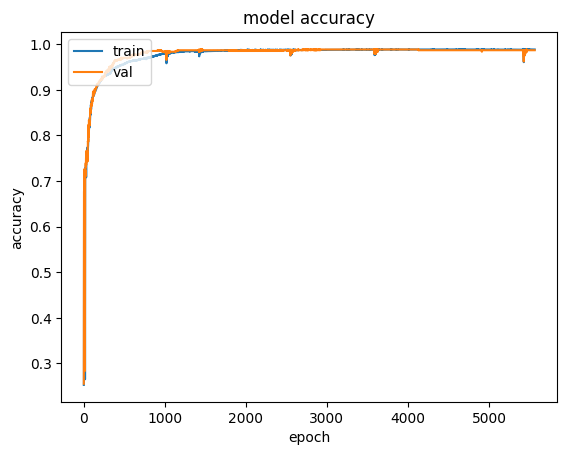

Model loss


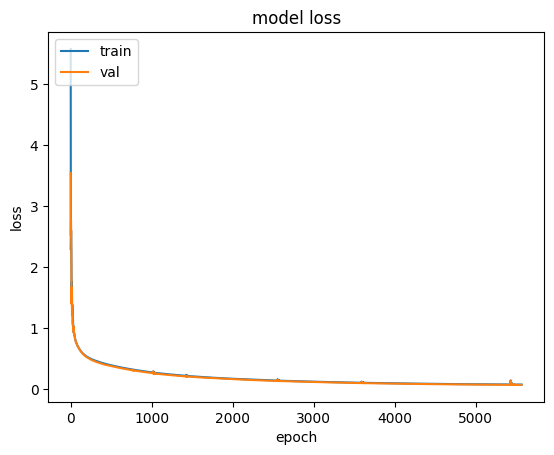

In [ ]:
# Historial de Accuracy
print('Accuracy')
plt.plot(history_model.history['accuracy'])
plt.plot(history_model.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

# Historial de pérdida
print('Model loss')
plt.plot(history_model.history['loss'])
plt.plot(history_model.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

## -- 3.3. Interpretación de Resultados

19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Accuracy: 0.9901153212520593
Precision: 0.967948717948718
Recall: 0.993421052631579
F1 score: 0.9805194805194806
ROC AUC: 0.991216020821284

Confusion matrix:
[[450   5]
 [  1 151]]


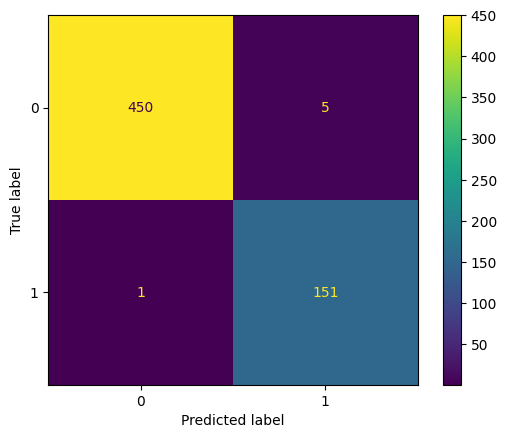

In [ ]:
# Predicciones
predictions_model = model.predict(x_test)
predictions_model = (predictions_model > 0.5).astype(int)

# Accuracy
acc = accuracy_score(y_test, predictions_model)
print(f'Accuracy: {acc}')

# Precision
pre = precision_score(y_test, predictions_model)
print(f'Precision: {pre}')

# Recall
rec = recall_score(y_test, predictions_model)
print(f'Recall: {rec}')

# F1 Score
f1 = f1_score(y_test, predictions_model)
print(f'F1 score: {f1}')

# ROC AUC
rocauc = roc_auc_score(y_test, predictions_model)
print(f'ROC AUC: {rocauc}')

print()

# Matriz de Confusión
cm = confusion_matrix(y_test, predictions_model)
print('Confusion matrix:')
print(cm)
ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1]).plot()
plt.show()
print()

In [ ]:
# Predicciones incorrectas del modelo para cada instancia en x_test
print(BOLD_ON + "Predicciones incorrectas del modelo:" + BOLD_OFF)
for i in range(len(x_test)):
    if y_test.iloc[i] != predictions_model[i]:
        print(BOLD_ON + "Instancia " +  str(i) + ":" + BOLD_OFF)
        for col, value in zip(x_test.columns, x_test.iloc[i].values):
            print("  -" + BOLD_ON + col +  BOLD_OFF + ":" + str(value))

        print("\n" + BOLD_ON + "Etiqueta real:\t  " +  BOLD_OFF, y_test.iloc[i].astype(int))
        print(BOLD_ON + "Etiqueta predicha:" +  BOLD_OFF, predictions_model[i][0])
        print("-" * 50)

Predicciones incorrectas del modelo:
Instancia 160:
  -latitude:49.0783
  -longitude:-128.9674
  -mag:4.5
  -depth:10.0

Etiqueta real:	   0
Etiqueta predicha: 1
--------------------------------------------------
Instancia 215:
  -latitude:19.1252
  -longitude:-64.2873
  -mag:3.7
  -depth:28.0

Etiqueta real:	   0
Etiqueta predicha: 1
--------------------------------------------------
Instancia 300:
  -latitude:38.1718
  -longitude:-117.7965
  -mag:4.3
  -depth:10.1

Etiqueta real:	   0
Etiqueta predicha: 1
--------------------------------------------------
Instancia 324:
  -latitude:33.1375
  -longitude:-115.64
  -mag:4.08
  -depth:4.59

Etiqueta real:	   0
Etiqueta predicha: 1
--------------------------------------------------
Instancia 344:
  -latitude:8.097
  -longitude:-39.522
  -mag:4.7
  -depth:10.0

Etiqueta real:	   0
Etiqueta predicha: 1
--------------------------------------------------
Instancia 406:
  -latitude:-55.9308
  -longitude:-27.8522
  -mag:6.4
  -depth:57.0

Etiqu

## -- 3.3 Implementación Técnicas XAI (SHAP)

### --- 3.3.1. Configuración SHAP

In [ ]:
def f(x):
    return model.predict(x).flatten()

def cambiarInstancia(pos):
  valoresInstanciaObjetivo = array([shap_values[pos]])
  x_test_instanciaObjetivo = x_test_sample.iloc[pos:pos + 1, :]

  return valoresInstanciaObjetivo, x_test_instanciaObjetivo

In [ ]:
x_train_sample = sample(x_train, 100, random_state = 1)
x_test_sample = sample(x_test, 100, random_state = 1)

In [ ]:
sh.initjs()

kernelExplainer = KernelExplainer(f, x_train_sample)
shap_values = kernelExplainer.shap_values(x_test_sample)

In [ ]:
explainer = sh.Explainer(f, x_train_sample)
shap_values_exp = explainer(x_test_sample)

### --- 3.3.2. Visualización de Valores SHAP

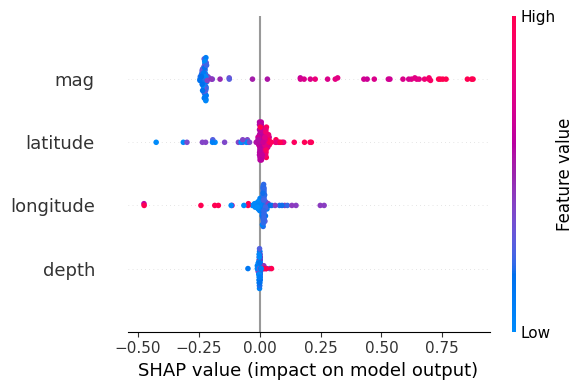

In [ ]:
summary_plot(shap_values, x_test_sample, max_display = 10, plot_size = [6,4])

In [ ]:
sh.initjs()
force_plot(kernelExplainer.expected_value, shap_values, x_train_sample)

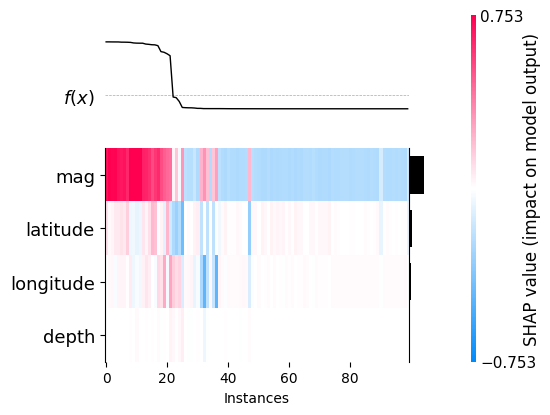

<Axes: xlabel='Instances'>

In [ ]:
sh.initjs()
heatmap(shap_values_exp, instance_order = shap_values_exp.sum(1))

---
# 4. Conclusiones

La gestión eficaz de datos sísmicos es crucial para la investigación y la prevención de desastres naturales. Sin embargo, la variabilidad en la obtención de datos, en términos de características y formatos, puede generar inconsistencias que dificultan su uso. Este proyecto aborda, en principio, esta problemática al unificar y normalizar toda la información en un solo dataset, haciéndolo más accesible y útil para fines investigativos y análisis científicos.

A través del análisis de los datos recopilados, se ha evidenciado que, en épocas anteriores, se registraban significativamente menos terremotos que en la actualidad o que hasta 1972, solo se documentaban aquellos eventos que superaban ciertos umbrales de magnitud, sugiriendo que los avances en la tecnología de medición y los cambios en el cálculo de la escala de Richter han contribuido a una mayor precisión en la recopilación de datos más recientes.

Además, este proyecto ha permitido la visualización geoespacial de los terremotos, facilitando la observación de que los eventos sísmicos tienden a ocurrir a lo largo de los límites de las placas tectónicas. Asimismo, se han identificado las regiones donde los terremotos de mayor magnitud son más frecuentes, proporcionando información valiosa sobre las áreas más vulnerables a estos eventos.

Por otro lado, el modelo de clasificación desarrollado, con una precisión del 0.98 y un F1-Score de 0.97, permite prever de manera rápida si un terremoto tiene el potencial de ser tsunamigénico, lo que constituye una herramienta fundamental para la toma de decisiones en situaciones de emergencia.

Finalmente, los resultados obtenidos han sido analizados mediante técnicas de inteligencia artificial explicativa (XAI), como SHAP, lo que facilita la comprensión de cómo los distintos atributos influyen en las predicciones del modelo. Este enfoque proporciona una mayor transparencia y confianza en las predicciones, permitiendo identificar los factores más determinantes en la clasificación de terremotos tsunamigénicos.

---
# 5. Vías Futuras

Entre las vías futuras de este proyecto se incluyen:
* **Automatización de la Recogida y Procesamiento de Datos**:
  * Desarrollar scripts que extraigan automáticamente información de sitios oficiales, como el [Instituto Geográfico Nacional (IGN)](https://www.ign.es/web/ultimos-terremotos)) para mantener el dataset actualizado con la información más reciente sobre terremotos.
* **Ampliación del Dataset con Información Histórica**:
  * Integrar más datasets históricos de otras fuentes con el objetivo de enriquecer y ampliar el dataset final, lo que permitirá mejorar la capacidad predictiva y la robustez del modelo de clasificación desarrollado.